In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import regex as reg
# from mpl_toolkits.basemap import Basemap
from networkx.algorithms.community import greedy_modularity_communities
from matplotlib.colors import ListedColormap
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

In [2]:
import os
os.environ["PROJ_LIB"] = r'/Users/zhechensu/anaconda3/envs/ada/share/proj'
from mpl_toolkits.basemap import Basemap

In [3]:
from wordcloud import WordCloud

In [4]:
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import tools
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

Loading the data about universities:

In [5]:
universities = pd.read_pickle('data/Universities.pkl')
universities.head()

,file,name,domain,email,author_order,country,Lat,Lon
0,2018_14,University of Colorado at Boulder,colorado.edu,Lehi6796@Colorado.EDU,0,United States,40.006667,-105.267222
1,2016_39,Michigan State University,msu.edu,acb@msu.edu,0,United States,42.725000,-84.480000
2,2016_39,University of North Carolina at Greensboro,uncg.edu,e_tan@uncg.edu,1,United States,36.069500,-79.811400
3,2016_39,Michigan State University,msu.edu,shinmyu4@msu.edu,2,United States,42.725000,-84.480000
4,2018_28,University of Illinois at Chicago,uic.edu,mlko@uic.edu,0,United States,41.871667,-87.649167


In [6]:
universities.rename(columns={'email': 'mail'}, inplace=True)

In [7]:
universities['merge_index'] = universities.apply(lambda x: x['file']+str(x['author_order']), axis=1)

metadata = pd.read_csv('data/Parsed_metadata.csv', index_col=0, parse_dates=['accessioned', 'available', 'issued'])
metadata.issued = metadata.issued.map(lambda x: x.year)
metadata['merge_index'] = metadata.apply(lambda x: x['file']+str(x['author_order']), axis=1)
associations = pd.merge(universities, metadata, on='merge_index')

In [8]:
associations.rename(columns={'file_x': 'file'}, inplace=True)

In [9]:
metadata.sort_values(by ='file')

,file,subject,iso,uri,type,publisher,title,issued,accessioned,citation,available,abstract,long_name,author_order,shortend_names,identifier,merge_index
1197,2014_1002-1006,[],en,https://doi.dx.org/10.22318/icls2014.1002,Book chapter,"Boulder, CO: International Society of the Lear...",Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Friend, Angela",1,Friend A.,"Caccamise, D., Friend, A., Groneman, C., Littr...",2014_1002-10061
2167,2014_1002-1006,[],en,https://doi.dx.org/10.22318/icls2014.1002,Book chapter,"Boulder, CO: International Society of the Lear...",Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Groneman, Christine",2,Groneman C.,"Caccamise, D., Friend, A., Groneman, C., Littr...",2014_1002-10062
3259,2014_1002-1006,[],en,https://doi.dx.org/10.22318/icls2014.1002,Book chapter,"Boulder, CO: International Society of the Lear...",Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Kintsch, Eileen",4,Kintsch E.,"Caccamise, D., Friend, A., Groneman, C., Littr...",2014_1002-10064
2841,2014_1002-1006,[],en,https://doi.dx.org/10.22318/icls2014.1002,Book chapter,"Boulder, CO: International Society of the Lear...",Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Littrell-Baez, Megan K.",3,Littrell-Baez M.,"Caccamise, D., Friend, A., Groneman, C., Littr...",2014_1002-10063
81,2014_1002-1006,[],en,https://doi.dx.org/10.22318/icls2014.1002,Book chapter,"Boulder, CO: International Society of the Lear...",Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Caccamise, Donna",0,Caccamise D.,"Caccamise, D., Friend, A., Groneman, C., Littr...",2014_1002-10060
2137,2014_1007-1011,[],en,https://doi.dx.org/10.22318/icls2014.1007,Book chapter,"Boulder, CO: International Society of the Lear...",Becoming a Computer Scientist: Early Results o...,2014,2018-05-21 22:08:51+00:00,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2018-05-21 22:08:51+00:00,This report describes the results of a pilot s...,"Thiry, Heather",2,Thiry H.,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2014_1007-10112
34,2014_1007-1011,[],en,https://doi.dx.org/10.22318/icls2014.1007,Book chapter,"Boulder, CO: International Society of the Lear...",Becoming a Computer Scientist: Early Results o...,2014,2018-05-21 22:08:51+00:00,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2018-05-21 22:08:51+00:00,This report describes the results of a pilot s...,"Denner, Jill",0,Denner J.,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2014_1007-10110
1154,2014_1007-1011,[],en,https://doi.dx.org/10.22318/icls2014.1007,Book chapter,"Boulder, CO: International Society of the Lear...",Becoming a Computer Scientist: Early Results o...,2014,2018-05-21 22:08:51+00:00,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2018-05-21 22:08:51+00:00,This report describes the results of a pilot s...,"Martinez, Jacob",1,Martinez J.,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2014_1007-10111
2284,2014_1012-1016,[],en,https://doi.dx.org/10.22318/icls2014.1012,Book chapter,"Boulder, CO: International Society of the Lear...","Science, Technology, Body and Personhood: The ...",2014,2018-05-21 22:08:51+00:00,"Raia, F., Cadeiras, M., Nsair, A., Cruz, D., R...",2018-05-21 22:08:51+00:00,"In this particip

In [10]:
associations[['file', 'title', 'long_name', 'author_order_y', 'shortend_names']].to_csv('author_data.csv', index=False)

In [11]:
associations.sort_values(by =['file', 'author_order_y']).head(10)

,file,name,domain,mail,author_order_x,country,Lat,Lon,merge_index,file_y,...,title,issued,accessioned,citation,available,abstract,long_name,author_order_y,shortend_names,identifier
1739,2014_1002-1006,University of Colorado at Boulder,colorado.edu,donna.caccamise@colorado.edu,0,United States,40.006667,-105.267222,2014_1002-10060,2014_1002-1006,...,Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Caccamise, Donna",0,Caccamise D.,"Caccamise, D., Friend, A., Groneman, C., Littr..."
1740,2014_1002-1006,University of Colorado at Boulder,colorado.edu,angela.friend@colorado.edu,1,United States,40.006667,-105.267222,2014_1002-10061,2014_1002-1006,...,Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Friend, Angela",1,Friend A.,"Caccamise, D., Friend, A., Groneman, C., Littr..."
1741,2014_1002-1006,University of Colorado at Boulder,colorado.edu,christine.groneman@colorado.edu,2,United States,40.006667,-105.267222,2014_1002-10062,2014_1002-1006,...,Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Groneman, Christine",2,Groneman C.,"Caccamise, D., Friend, A., Groneman, C., Littr..."
1742,2014_1002-1006,University of Colorado at Boulder,colorado.edu,megan.littrellbaez@colorado.edu,3,United States,40.006667,-105.267222,2014_1002-10063,2014_1002-1006,...,Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Littrell-Baez, Megan K.",3,Littrell-Baez M.,"Caccamise, D., Friend, A., Groneman, C., Littr..."
1743,2014_1002-1006,University of Colorado at Boulder,colorado.edu,eileen.kintsch@colorado.edu,4,United States,40.006667,-105.267222,2014_1002-10064,2014_1002-1006,...,Teaching Struggling Middle School Readers to C...,2014,2018-05-21 22:08:51+00:00,"Caccamise, D., Friend, A., Groneman, C., Littr...",2018-05-21 22:08:51+00:00,This project involves developing a reading com...,"Kintsch, Eileen",4,Kintsch E.,"Caccamise, D., Friend, A., Groneman, C., Littr..."
2743,2014_1007-1011,NaN,etr.org,jacobm@etr.org,0,Brazil,NaN,NaN,2014_1007-10110,2014_1007-1011,...,Becoming a Computer Scientist: Early Results o...,2014,2018-05-21 22:08:51+00:00,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2018-05-21 22:08:51+00:00,This report describes the results of a pilot s...,"Denner, Jill",0,Denner J.,"Denner, J., Martinez, J., & Thiry, H. (2014). ..."
2744,2014_1007-1011,Golden Evaluation and Policy Research,goldeneval.com,heather.thiry@goldeneval.com,1,NaN,NaN,NaN,2014_1007-10111,2014_1007-1011,...,Becoming a Computer Scientist: Early Results o...,2014,2018-05-21 22:08:51+00:00,"Denner, J., Martinez, J., & Thiry, H. (2014). ...",2018-05-21 22:08:51+00:00,This report describes the results of a pilot s...,"Martinez, Jacob",1,Martinez J.,"Denner, J., Martinez, J., & Thiry, H. (2014). ..."
742,2014_1012-1016,"University of California, Los Angeles",ucla.edu,raia@gseis.ucla.edu,0,United States,34.069444,-118.445278,2014_1012-10160,2014_1012-1016,...,"Science, Technology, Body and Personhood: The ...",2014,2018-05-21 22:08:51+00:00,"Raia, F., Cadeiras, M., Nsair, A., Cruz, D., R...",2018-05-21 22:08:51+00:00,"In this participatory action research project,...","Raia, Federica",0,Raia F.,"Raia, F., Cadeiras, M., Nsair, A., Cruz, D., R..."
743,2014_1012-1016,"University of California, Los Angeles",ucla.edu,MCadeiras@mednet.ucla.edu,1,United States,34.069444,-118.445278,2014_1012-10161,2014_1012-1016,...,"Science, Technology, Body and Personhoo

# Looking at co authorship, taking into consideration country and inst.

We use the associations frame again to build a co-authorship graph based on people with attributes country and institution

In [12]:
print(associations.columns)
#we can drop one of the file columns
(associations.file != associations.file_y).sum()

Index(['file', 'name', 'domain', 'mail', 'author_order_x', 'country', 'Lat',
       'Lon', 'merge_index', 'file_y', 'subject', 'iso', 'uri', 'type',
       'publisher', 'title', 'issued', 'accessioned', 'citation', 'available',
       'abstract', 'long_name', 'author_order_y', 'shortend_names',
       'identifier'],
      dtype='object')


0

In [13]:
associations['subject'] = associations.subject.map(lambda x: [reg.sub("'|,|\[|\]", '', y).lower().strip() for y in x.split(',')])

In [14]:
del associations['file_y']

In [15]:
associations = associations[associations.country.notna()]

In [16]:
self_merge = pd.merge(associations, associations, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = associations[~associations.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

In [17]:
self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

In [18]:
def get_adjacency(nodes, edges):
    n_nodes = len(nodes)
    adjacency = np.zeros((n_nodes, n_nodes), dtype=int)

    for idx, row in edges.iterrows():
        i, j = int(row.source), int(row.target)
        adjacency[i, j] += 1

    return adjacency

In [19]:
adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)

Adding attributes to the graph:

In [20]:
edge_dict = {}
keyword_dict = {}
for i, row in self_merge.iterrows():
    edge_dict[(row['source'], row['target'])] =  row['issued_x']
    keyword_dict[(row['source'], row['target'])] =  row['subject_x']

In [21]:
nx.set_edge_attributes(graph, edge_dict, name='year')
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
mapping = nodes.long_name.to_dict()

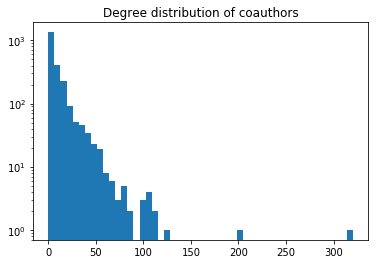

In [22]:
plt.title('Degree distribution of coauthors')
plt.hist(adjacency.sum(axis=1), bins=50, log=True)
plt.show()

Component sizes:

In [23]:
pd.Series([len(i) for i in list(nx.connected_components(graph))]).value_counts().sort_index()

1       72
2       59
3       39
4       25
5       19
6        5
7        7
8        1
9        4
10       1
11       4
13       1
1591     1
dtype: int64

This is a simple drawing of our network: we see that there is a large core communit, and many many smaller comminitues of co authors. We will look more into the main community

In [24]:
#pos = nx.drawing.layout.kamada_kawai_layout(graph)

In [25]:
#pos = nx.layout.spring_layout(graph)
pos = nx.layout.fruchterman_reingold_layout(graph)

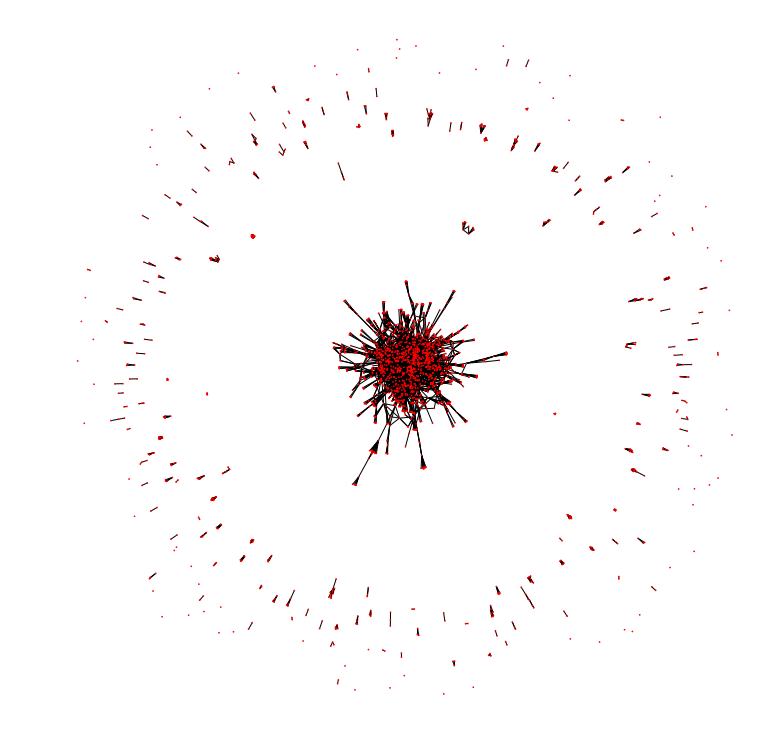

In [26]:
plt.figure(figsize=(10, 10))
nx.draw(graph, pos=pos, node_size=[0.5,0.5])

In [27]:
embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)

In [28]:
weight = nx.get_edge_attributes(graph, 'weight')

We focus in on the different components:

In [29]:
#get components
largest_cc = max(nx.connected_components(graph), key=len)

The total number of components is:

In [30]:
nx.number_connected_components(graph)

238

In [31]:
print('the largest component contains : {} people'.format(len(largest_cc)))

the largest component contains : 1591 people


Use centrality to highlight nodes that function as "bridges" between people

In [32]:
centrality = nx.betweenness_centrality(graph.subgraph(largest_cc))

In [33]:
np.quantile(np.array(list(centrality.values())), 0.9)

0.007375139373099003

In [34]:
lables = nodes['long_name'].to_dict()

lables = { key: lables[key] for (key, value) in centrality.items() if value > 0.03}

In [35]:
node_size = np.array(list(centrality.values()))*5000

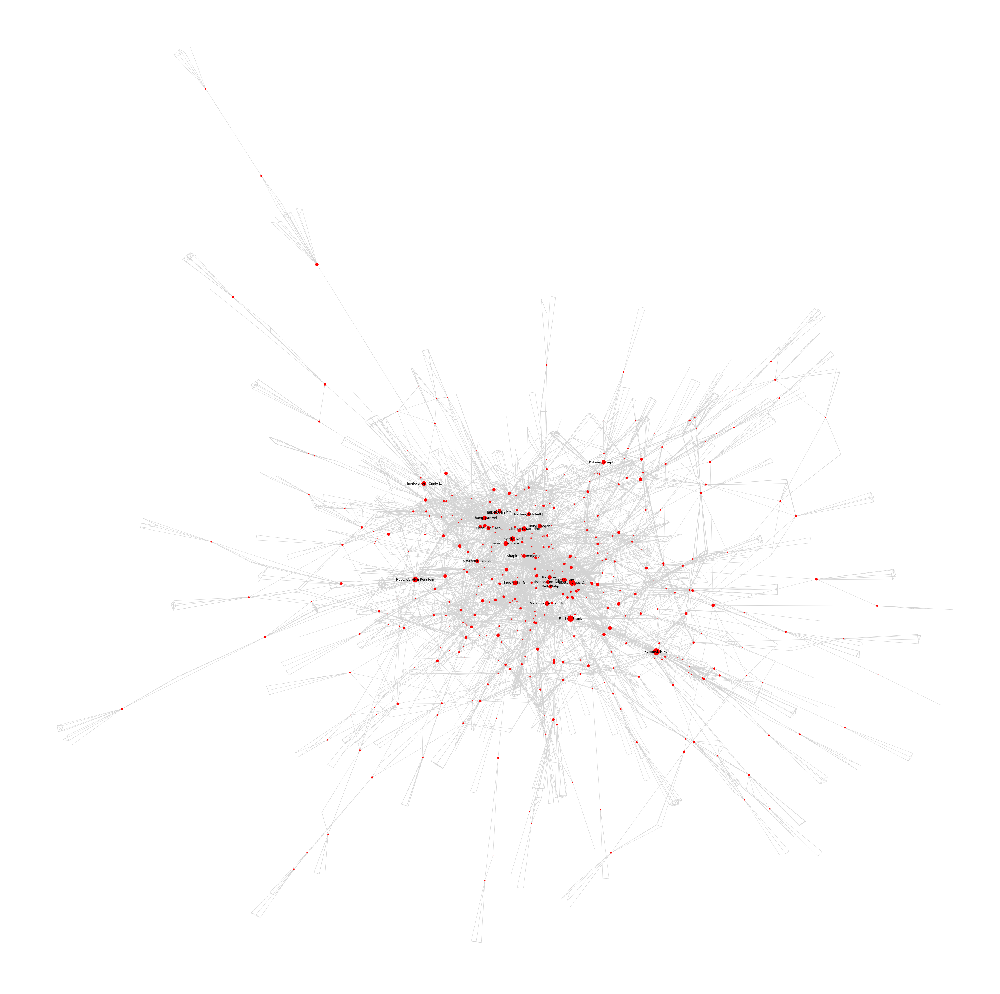

In [36]:
plt.figure(figsize=(50, 50))
nx.draw(graph.subgraph(largest_cc), node_size=node_size, edge_color='lightgray', labels=lables)

In [37]:
nx.average_shortest_path_length(graph.subgraph(largest_cc))

4.775288671734481

In [38]:
nx.average_clustering(graph.subgraph(largest_cc))

0.8075979268545728

In [39]:
nx.density(graph.subgraph(largest_cc))

0.006123279927580059

**Same graph for people who collaborated at least on 3 papers:**

e.g. we look at frequent collaborators (also forming a main component)

In [40]:
G = nx.Graph(((source, target, attr) for source, target, attr in graph.edges(data=True) if attr['weight'] > 1))
nx.set_node_attributes(G, nodes.country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(G, nodes.long_name.to_dict(), name='author')

largest_ccs = [i for i in nx.connected_components(G) if len(i) > 6 and len(i) < 20]#if len(i) > 9 and len(i) < 20]
len(largest_ccs)

4

In [41]:
[len(i) for i in largest_ccs]

[7, 8, 7, 10]

In [42]:
lc = max(nx.connected_components(G), key=len)

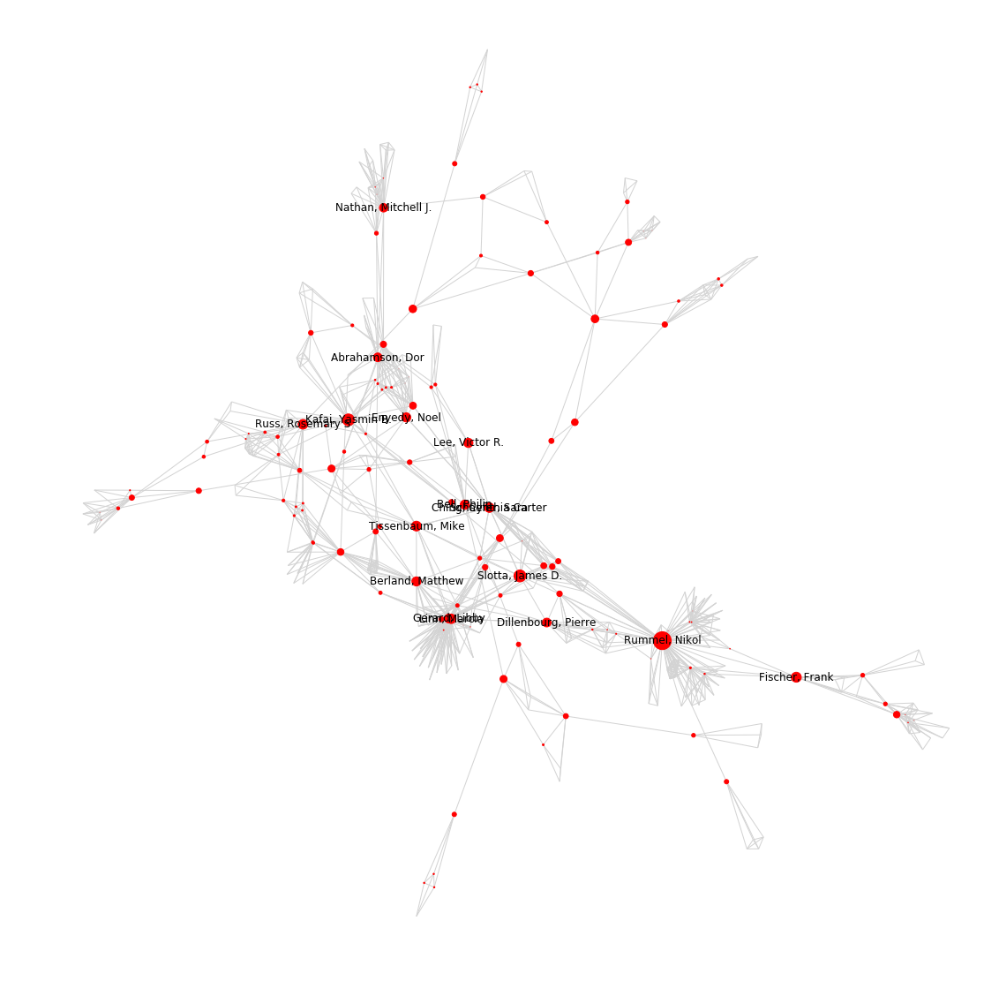

In [43]:
core = nx.k_core(G.subgraph(lc), k=3)
core = core.subgraph(max(nx.connected_components(core), key=len))
node_size = pd.Series(nx.betweenness_centrality(core))
labels = nx.get_node_attributes(core.subgraph(node_size[node_size.quantile(0.95) < node_size].index), 'author')
plt.figure(figsize=(15, 15))
pos= nx.layout.spring_layout(core)
nx.draw(core,pos=pos, edge_color='lightgray', node_size=node_size*1000, span=0.01, labels=labels, seed=2)
plt.savefig('figures/author_collab_large')

In [44]:
pd.Series(nx.get_node_attributes(core, 'country')).value_counts().shape

(16,)

In [45]:
palette = sns.color_palette(palette="tab20c_r", n_colors=20).as_hex()

In [46]:
core = nx.k_core(G.subgraph(lc), k=3)
core = core.subgraph(max(nx.connected_components(core), key=len))
node_size = pd.Series(nx.betweenness_centrality(core))


helper = sorted(list(set(nx.get_node_attributes(core, 'country').values())))
labels = nx.get_node_attributes(core.subgraph(node_size[node_size.quantile(0.92) < node_size].index), 'author')
node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(core, 'country').values()]

In [47]:
import matplotlib.patches as mpatches

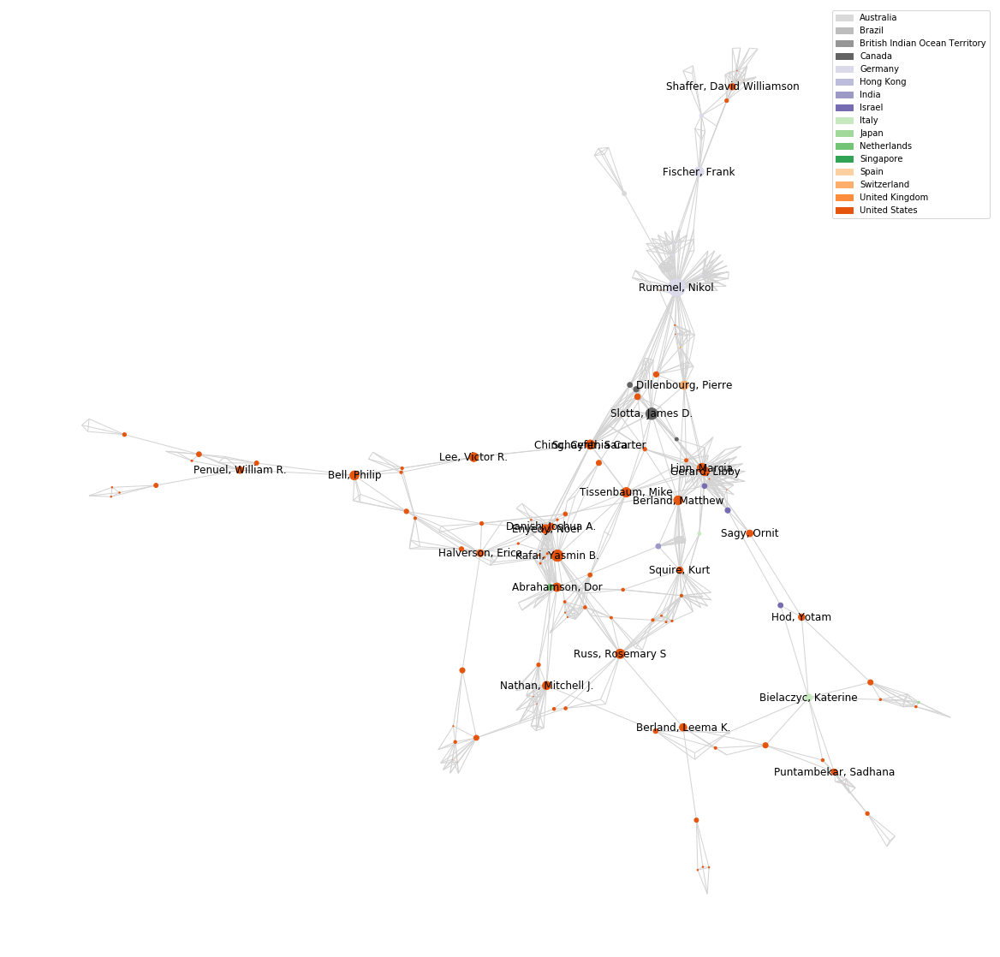

In [48]:
plt.figure(figsize=(20, 20))
    
#draw legend
legend = []
for ind, name in enumerate(helper):
    legend.append(mpatches.Patch(color=palette[ind], label=name))
plt.legend(handles=legend)

pos= nx.layout.spectral_layout(core)
pos = nx.layout.spring_layout(core, pos=pos, iterations=100)
nx.draw(core,pos=pos, edge_color='lightgray', node_size=node_size*1000, 
        span=0.01, labels=labels, node_color=node_color)
plt.savefig('figures/author_collab_large')

In [49]:
nx.write_gpickle(core, "core.gpickle")

In [50]:
from plotly import tools
from plotly.offline import iplot, init_notebook_mode

import plotly.plotly as py
from plotly.graph_objs import *

init_notebook_mode()

In [51]:
core = nx.read_gpickle("core.gpickle")

In [52]:
N = core.number_of_nodes()
nodes_ = core.nodes
E = core.edges.keys()

Xv=[pos[k][0] for k in nodes_]
Yv=[pos[k][1] for k in nodes_]

Xed=[]
Yed=[]
for edge in E:
    Xed+=[pos[edge[0]][0],pos[edge[1]][0], None]
    Yed+=[pos[edge[0]][1],pos[edge[1]][1], None] 
    
trace3=Scatter(x=Xed,
               y=Yed,
               mode='lines',
               line=dict(color='rgb(210,210,210)', width=1),
               hoverinfo='none'
               )
trace4=Scatter(x=Xv,
               y=Yv,
               mode='markers',
               name='net',
               marker=dict(symbol='circle-dot',
                             size=node_size*50, 
                             color=pd.Series(node_color).tolist(),
                             line=dict(color='rgb(50,50,50)', width=0.5)
                             ),
               text=list(nx.get_node_attributes(core, 'author').values()),
               hoverinfo='text'
               )


data1=[trace3, trace4]


layout=Layout(title= "Core of university graph",
    font= dict(size=12),
    showlegend=False,
    autosize=False,
    width=700,
    height=700,      
    hovermode='closest',
    annotations=[
           dict(
           showarrow=False, 
            xref='paper',     
            yref='paper',     
            x=0,  
            y=-0.1,  
            xanchor='left',   
            yanchor='bottom',  
            font=dict(
            size=14 
            )     
            )
        ]          
    )


fig1=Figure(data=data1, layout=layout)
#fig1['layout']['annotations'][0]['text']=annot

iplot(fig1, validate=False)

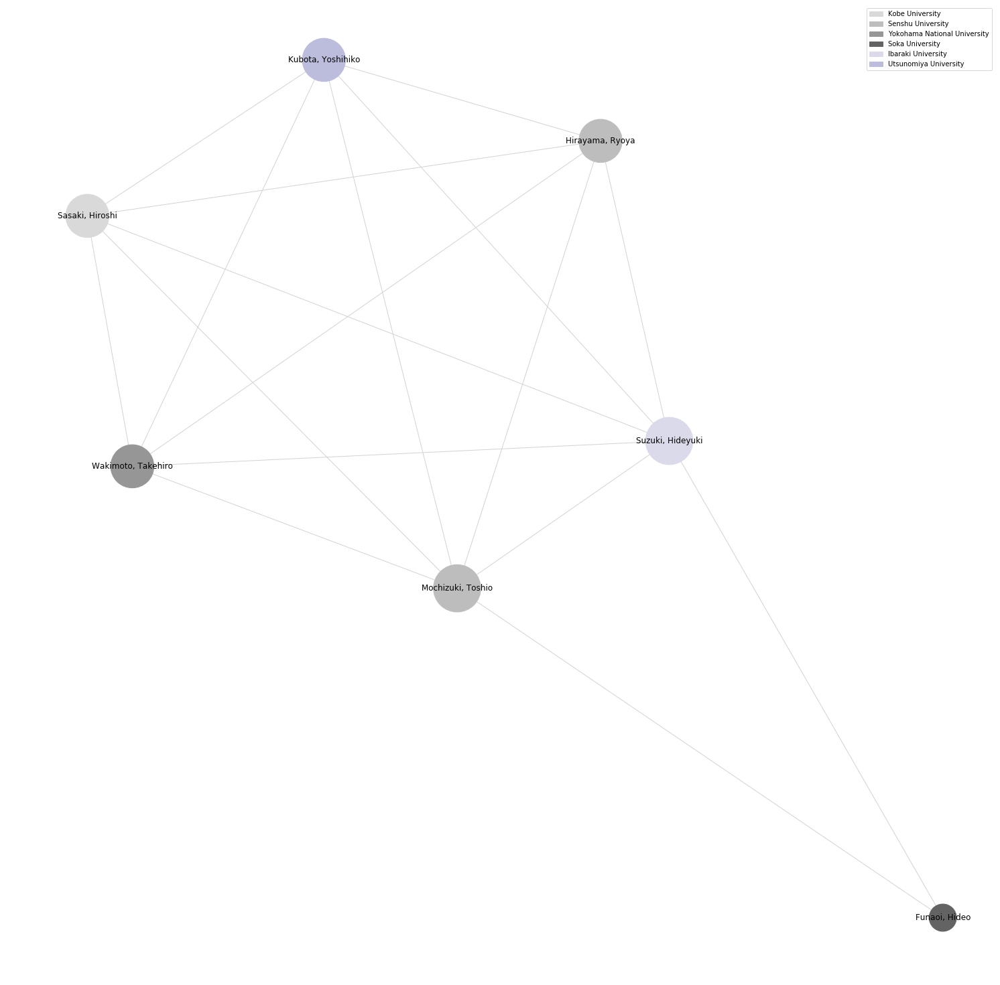

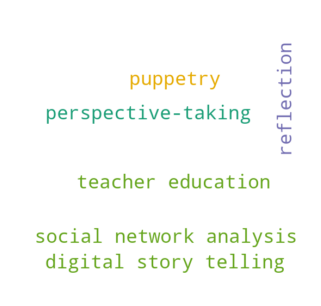

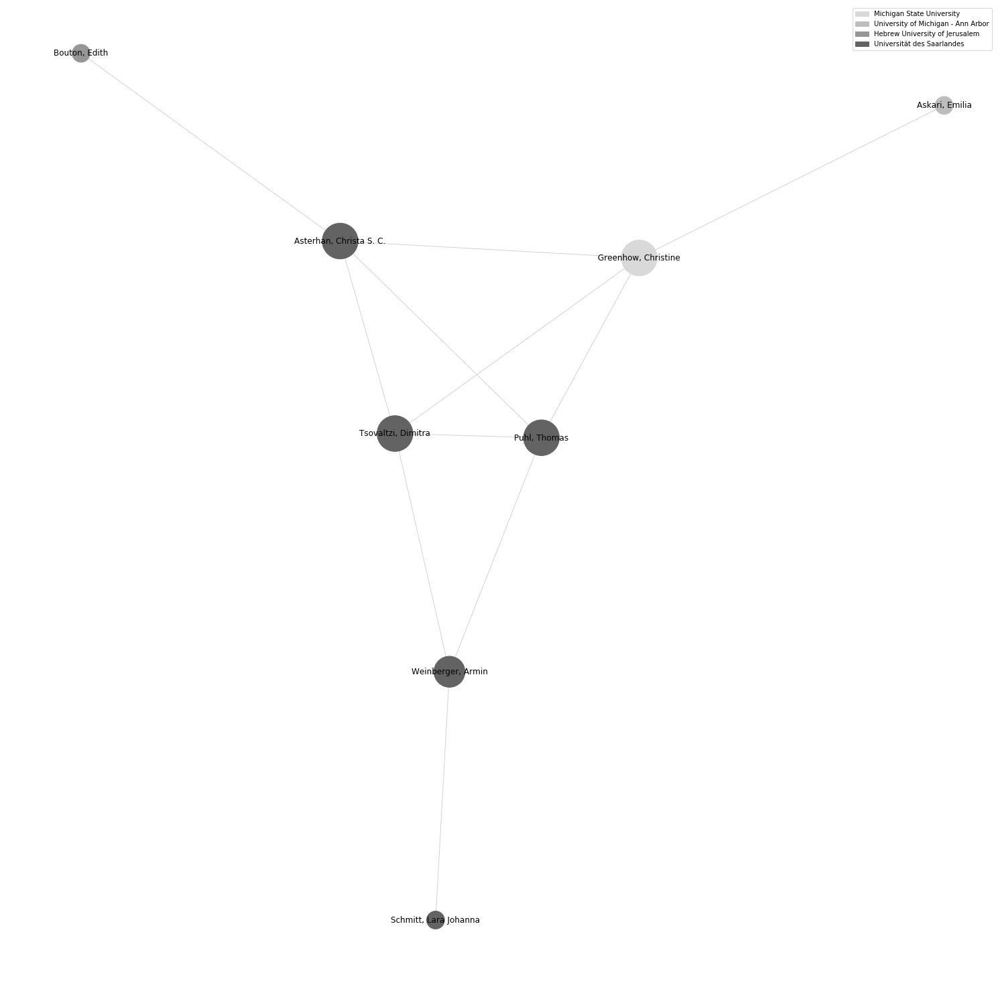

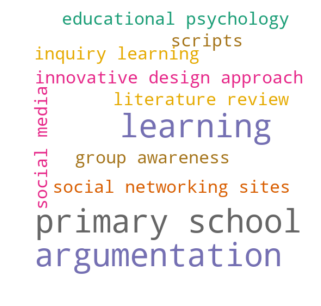

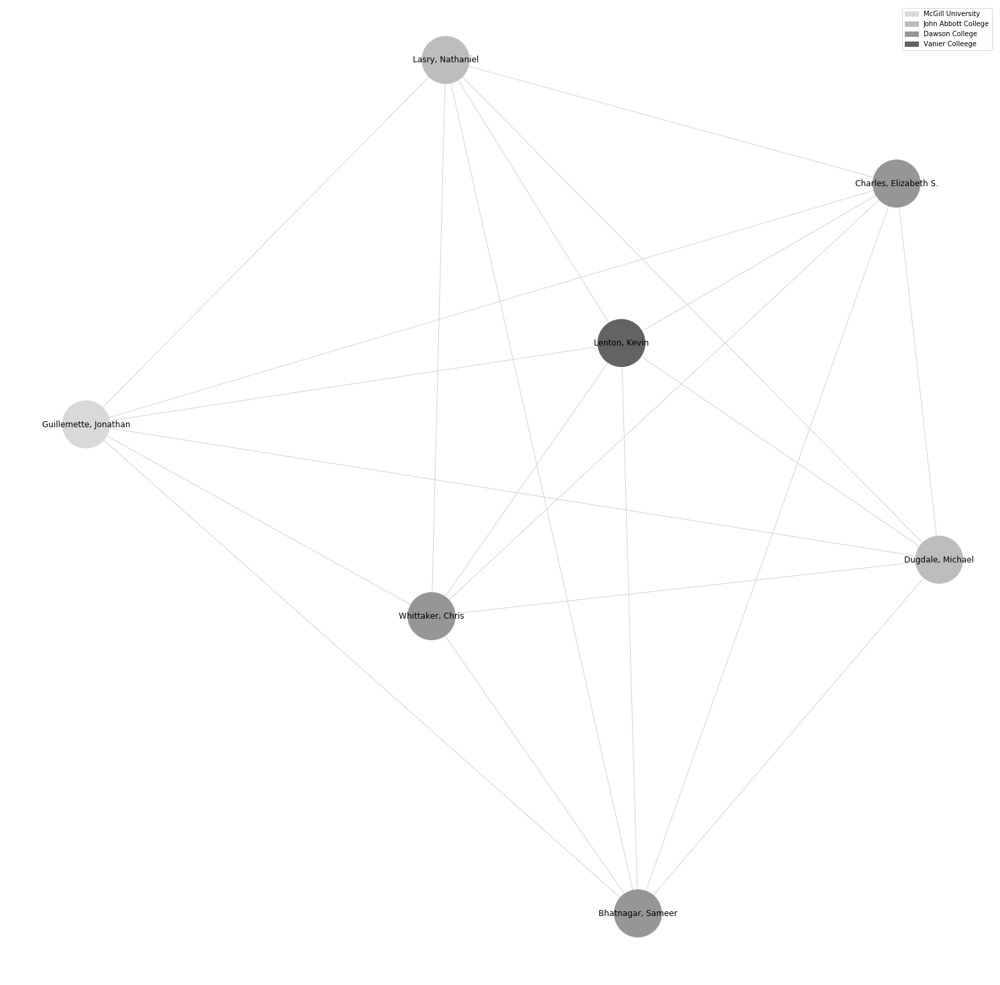

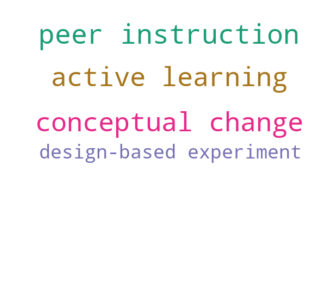

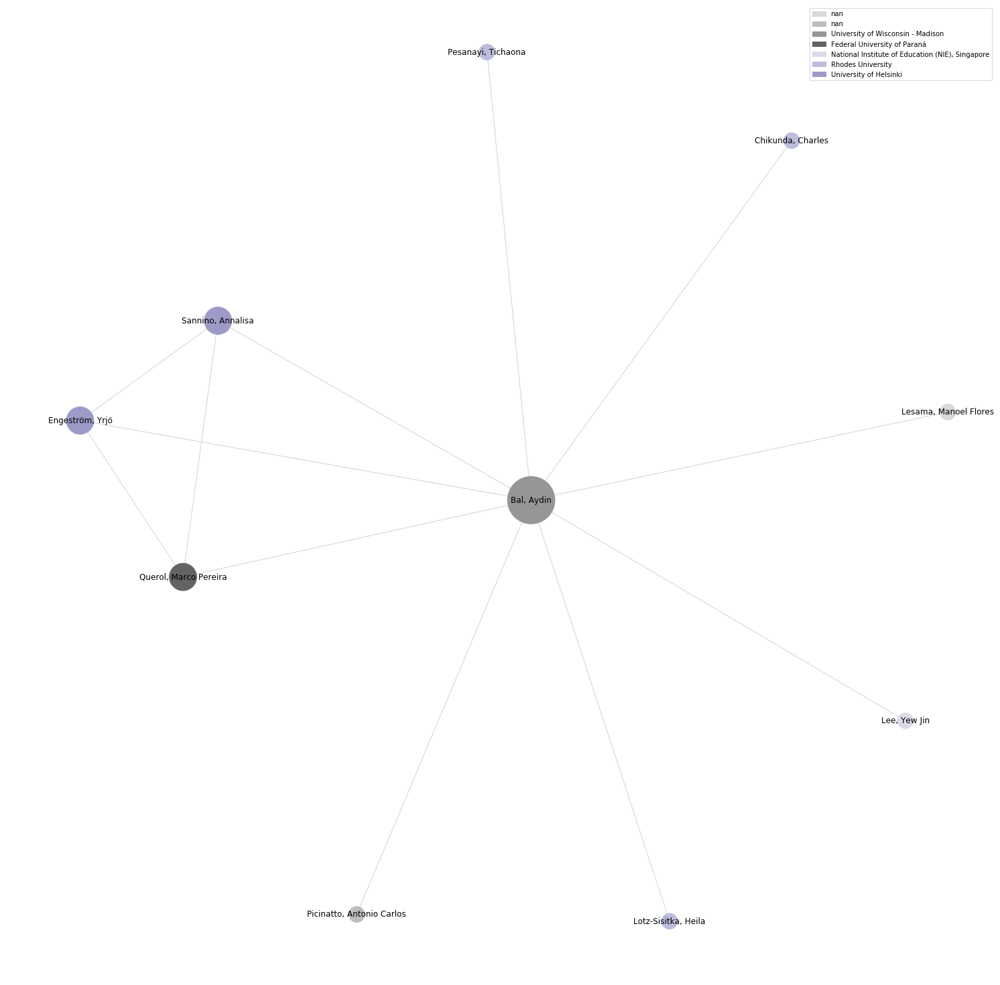

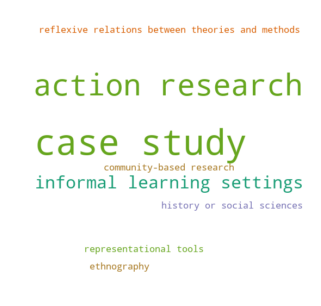

In [53]:
for largest_cc_strong in largest_ccs:
    
    helper = list(set(nx.get_node_attributes(
        G.subgraph(largest_cc_strong), 'uni').values()))
    node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(G.subgraph(largest_cc_strong), 'uni').values()]
    
    plt.figure(figsize=(20, 20))
    
    node_size = np.array(list(nx.degree_centrality(G.subgraph(largest_cc_strong)).values()))

    lables = nodes.iloc[list(largest_cc_strong)]['long_name'].to_dict()
    nx.draw_spring(G.subgraph(largest_cc_strong), node_size=node_size*5000, labels=lables, edge_color='lightgray',
                  node_color=node_color)
    #draw legend
    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    
    plt.show()
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(largest_cc_strong), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()

    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=keywords.shape[0], 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()

Drawing it in a geographical embedding:

#### Collaboration in the graph over the years:

In [54]:
edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].drop_duplicates()
counts = edges.groupby(['long_name_x', 'long_name_y']).count()
counts.issued_x.value_counts()

1    16398
2      846
3      122
4       44
5        6
Name: issued_x, dtype: int64

In [55]:
edge_dict = {}
keyword_dict = {}
for i, row in counts[counts.issued_x > 1].reset_index().iterrows():
    keywords = self_merge[(self_merge.long_name_x == row.long_name_x) & 
                     (self_merge.long_name_y == row.long_name_y)].subject_x
    keywords = [i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j if len(i) > 0]
    keyword_dict[(row.long_name_x, row.long_name_y)] = keywords

In [56]:
G = nx.from_pandas_edgelist(counts[counts.issued_x > 1].reset_index(), 
                        source='long_name_x', target='long_name_y', edge_attr=['issued_x'])
nx.set_node_attributes(G, nodes.set_index('long_name').country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.set_index('long_name').name.to_dict(), name='uni')
nx.set_edge_attributes(G, keyword_dict, name='keywords')

In [57]:
palette = sns.color_palette(palette="tab20", n_colors=25).as_hex()

In [58]:
[len(i) for i in list(nx.connected_components(G)) if len(i) > 7]

[59, 8, 36, 8, 8, 30, 9, 9, 8]

_______
subgraph 0
________


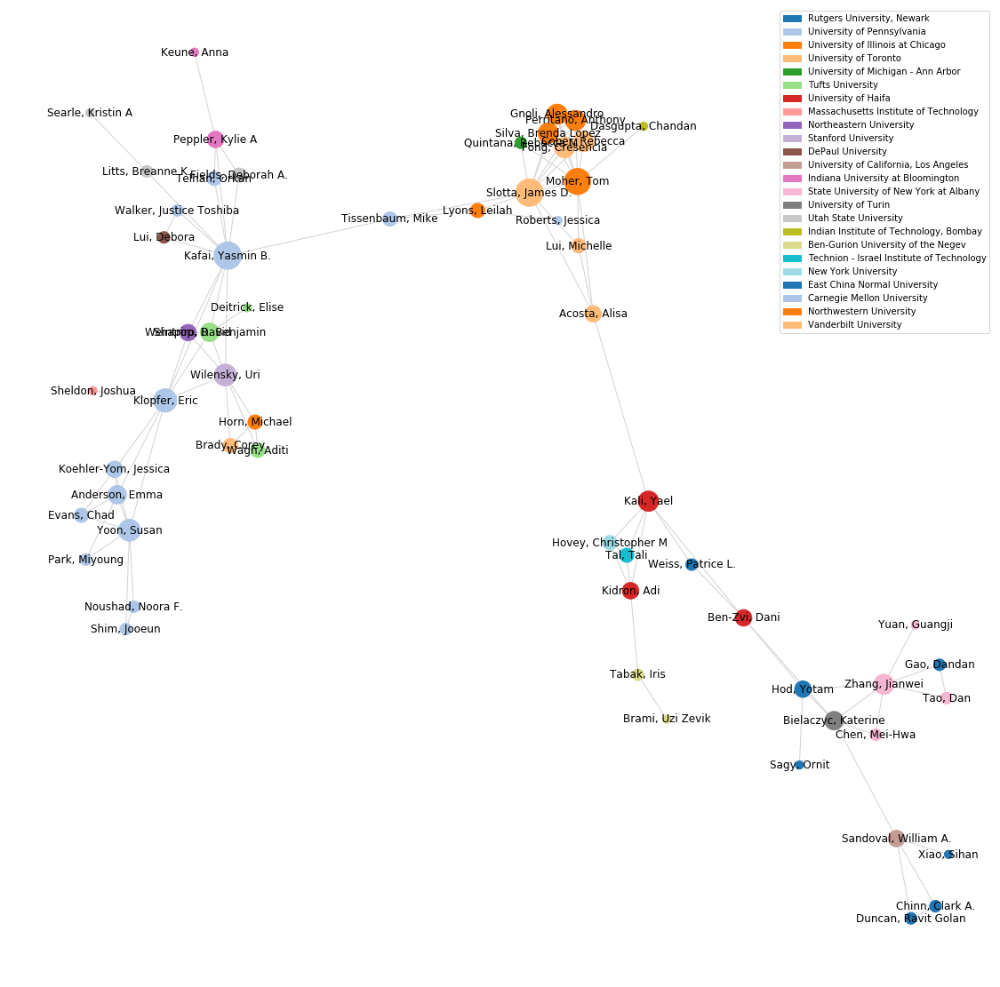

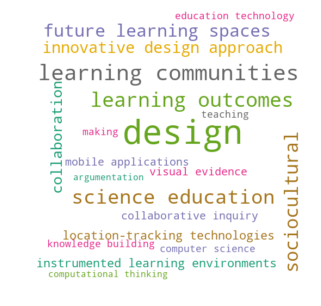

_______
subgraph 1
________


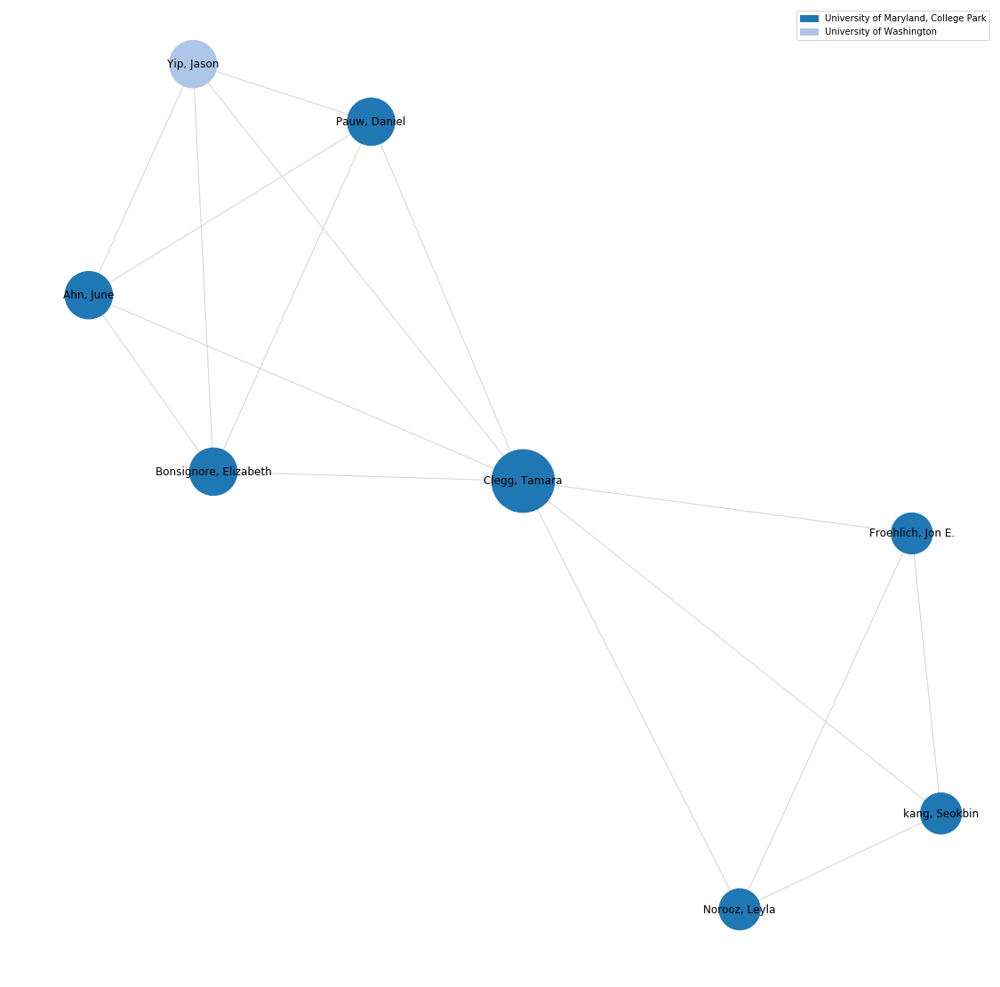

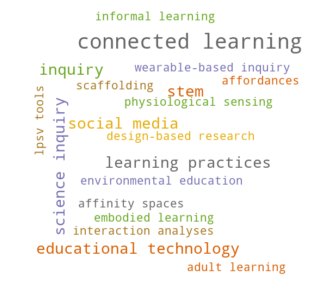

_______
subgraph 2
________


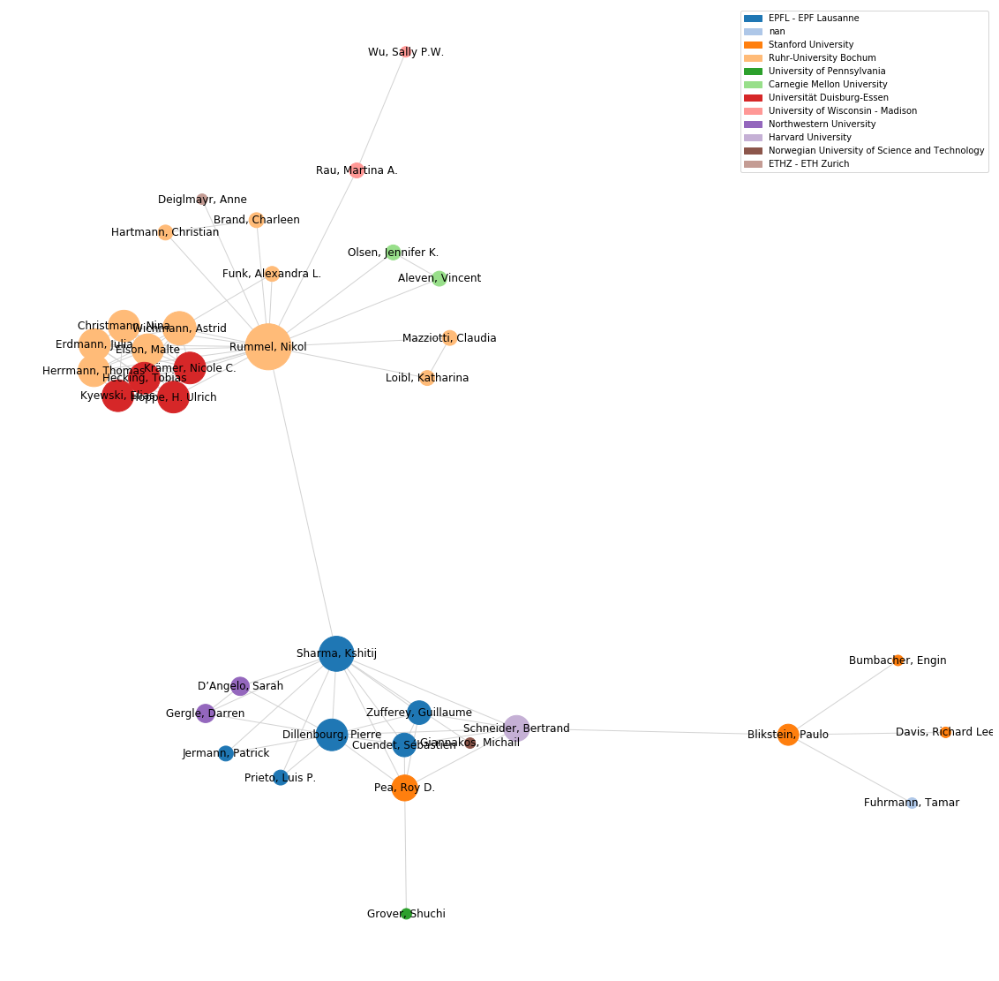

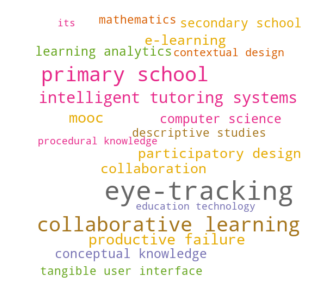

_______
subgraph 3
________


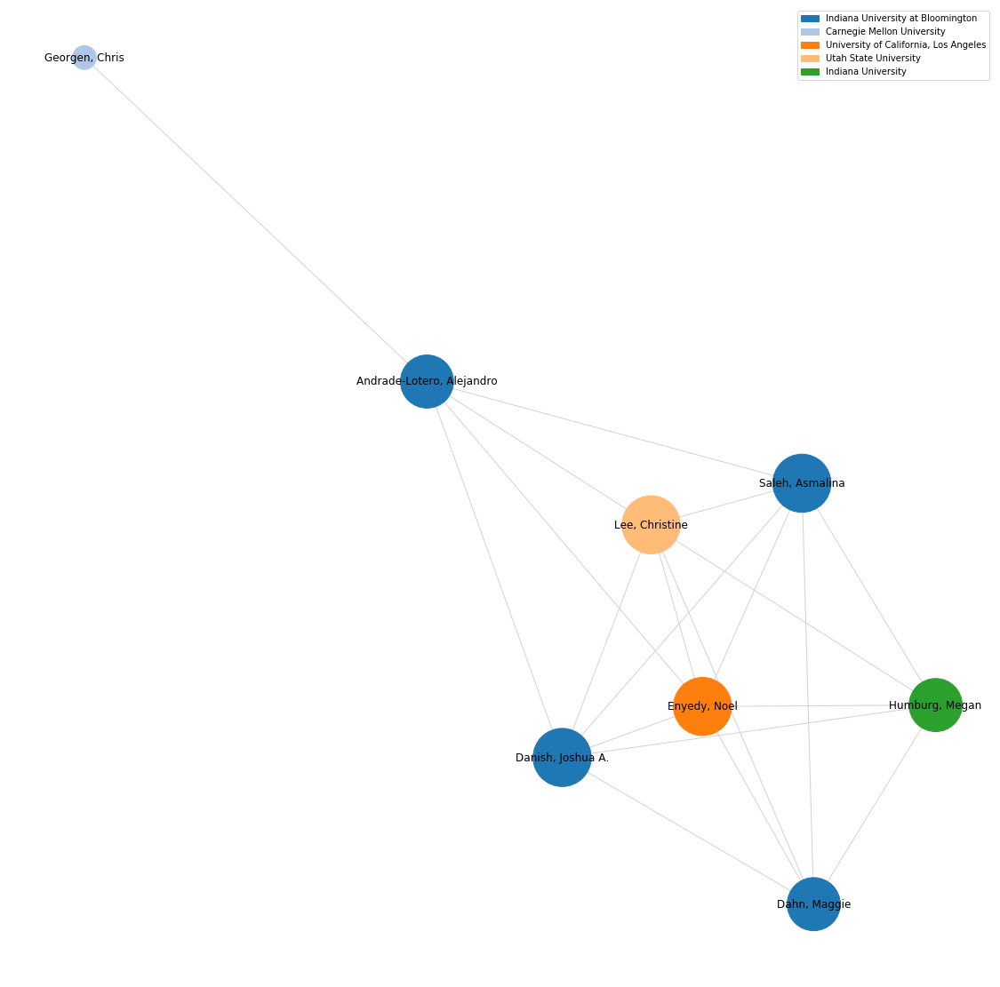

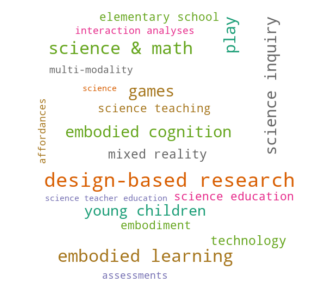

_______
subgraph 4
________


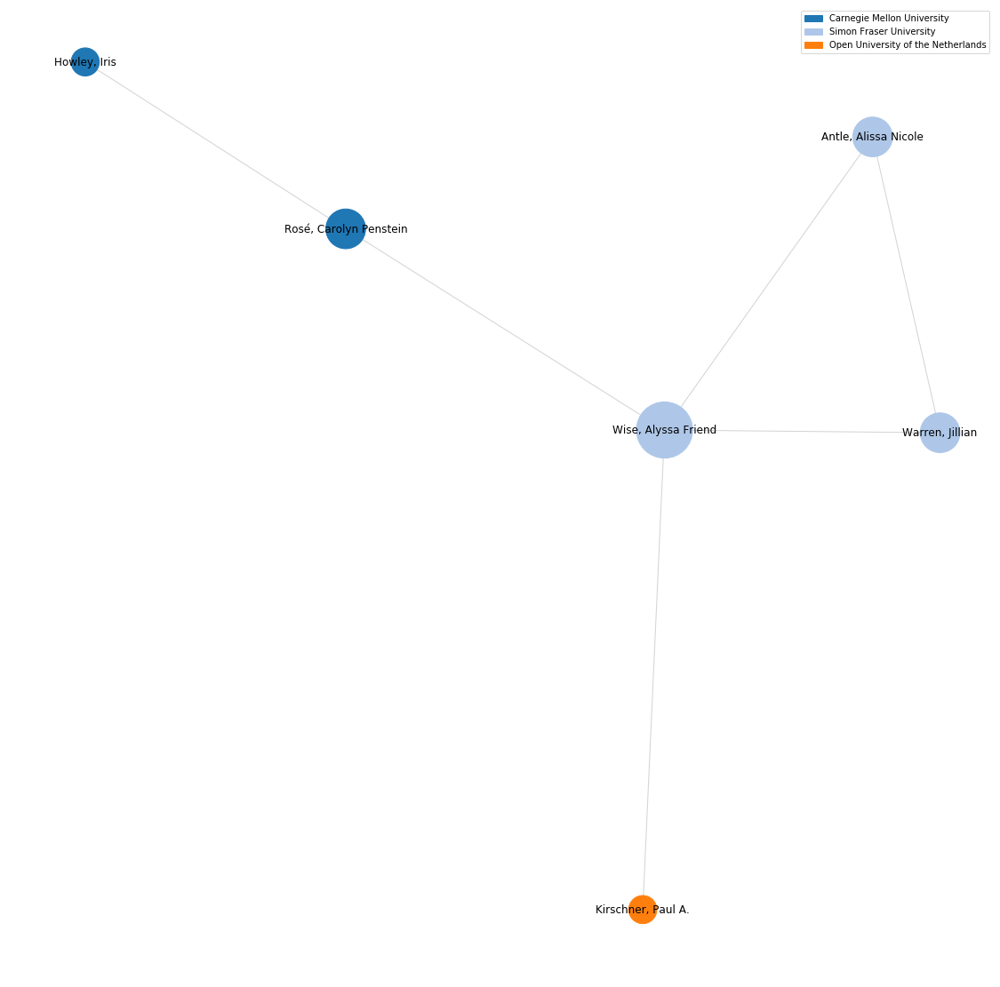

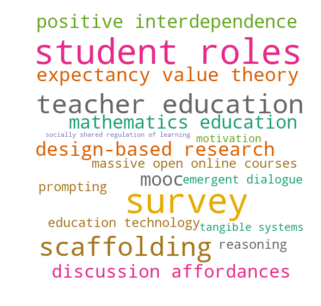

_______
subgraph 5
________


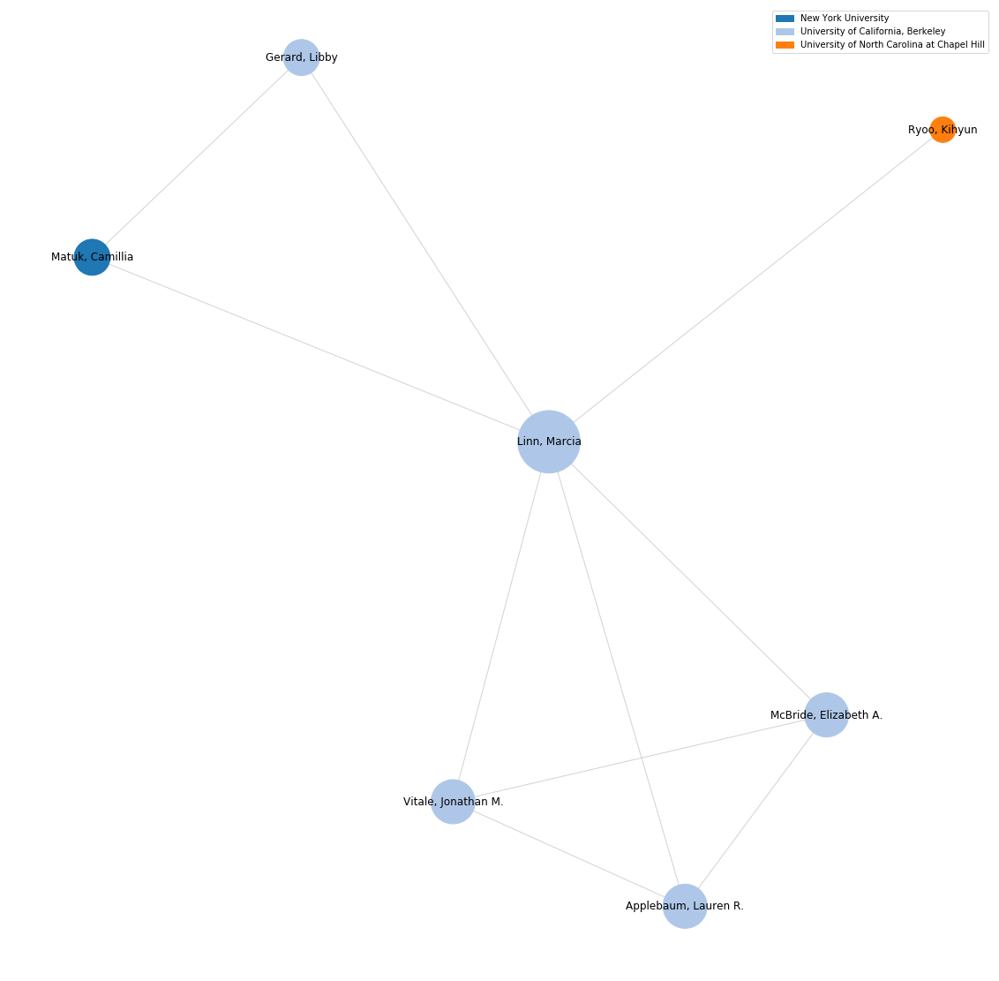

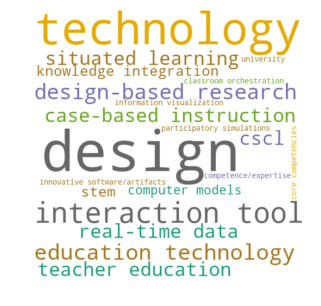

_______
subgraph 6
________


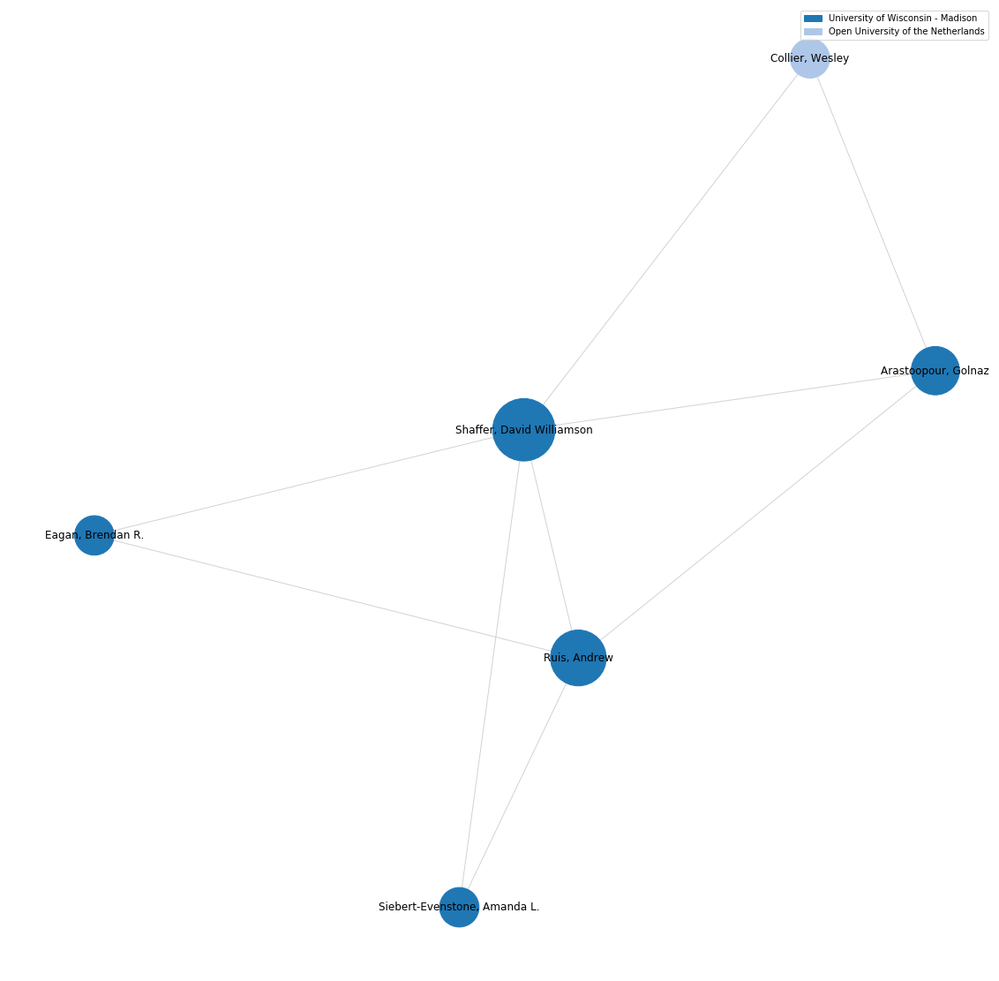

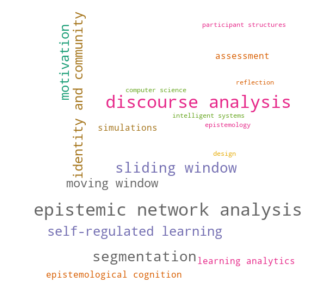

_______
subgraph 7
________


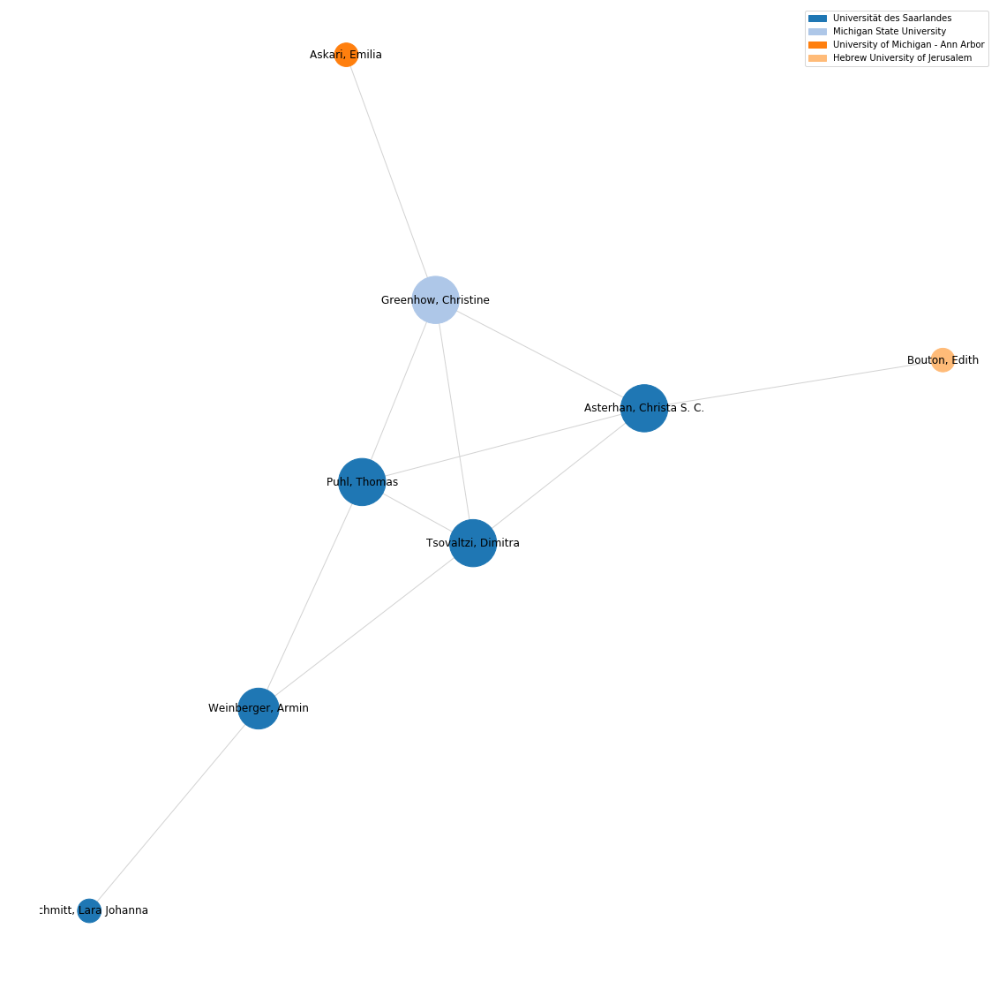

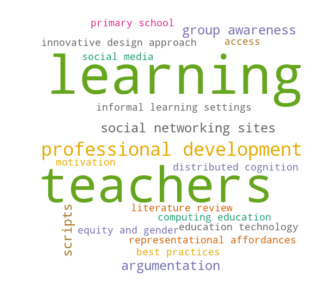

_______
subgraph 8
________


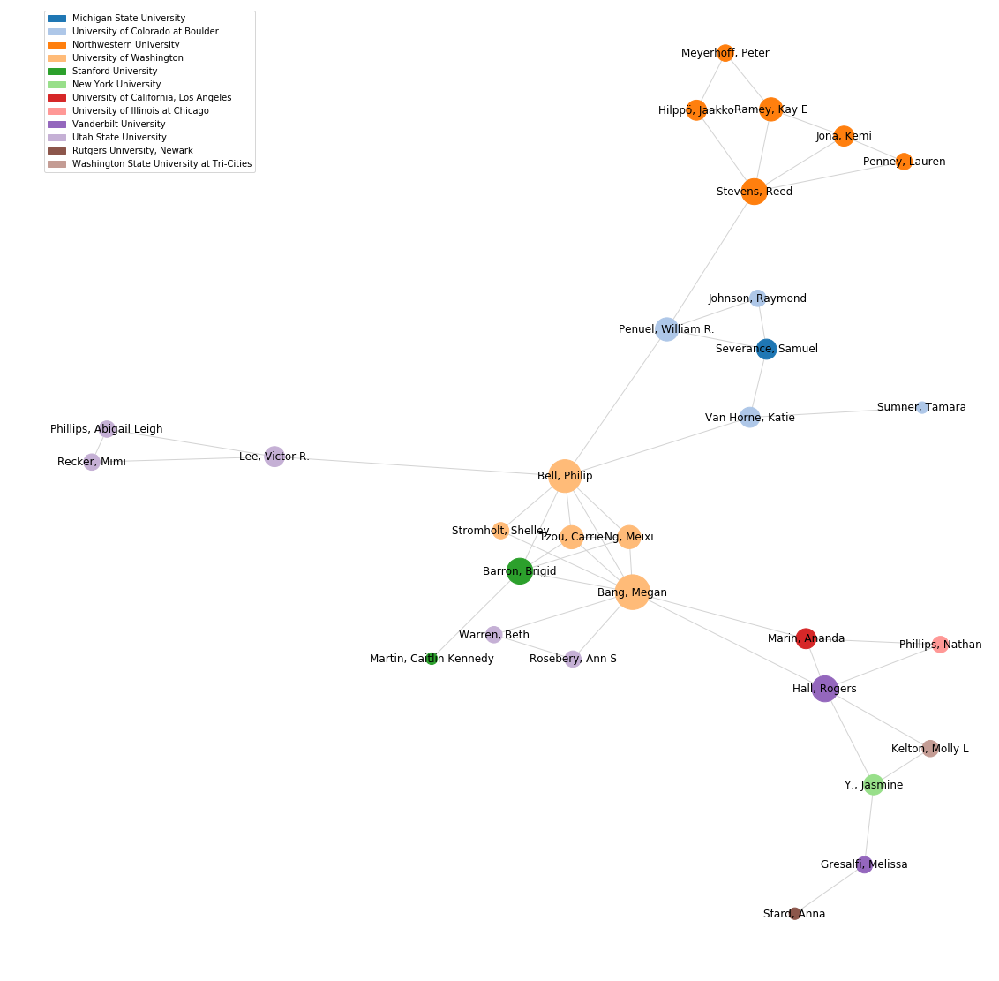

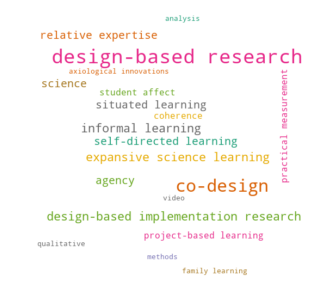

_______
subgraph 9
________


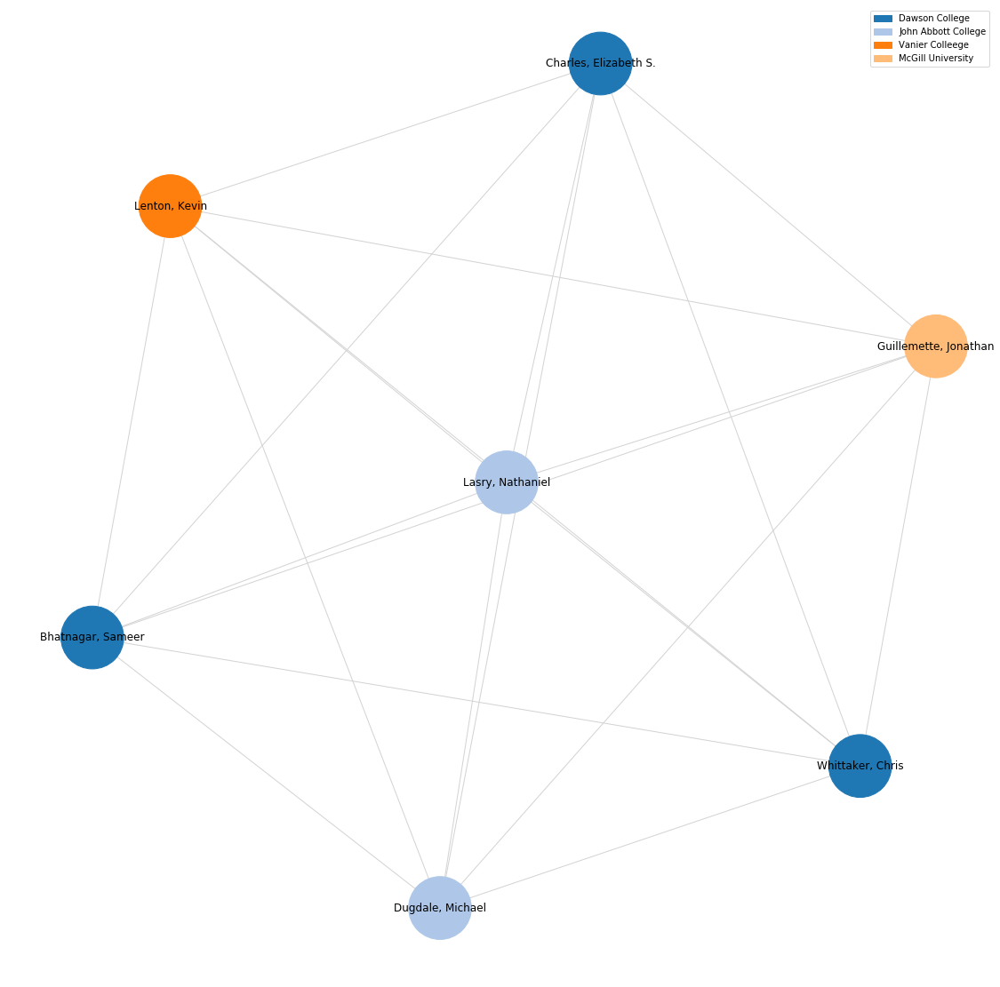

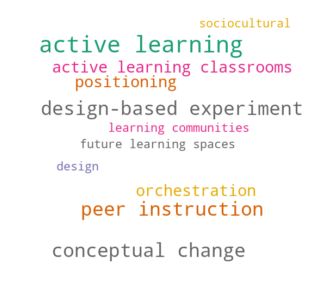

_______
subgraph 10
________


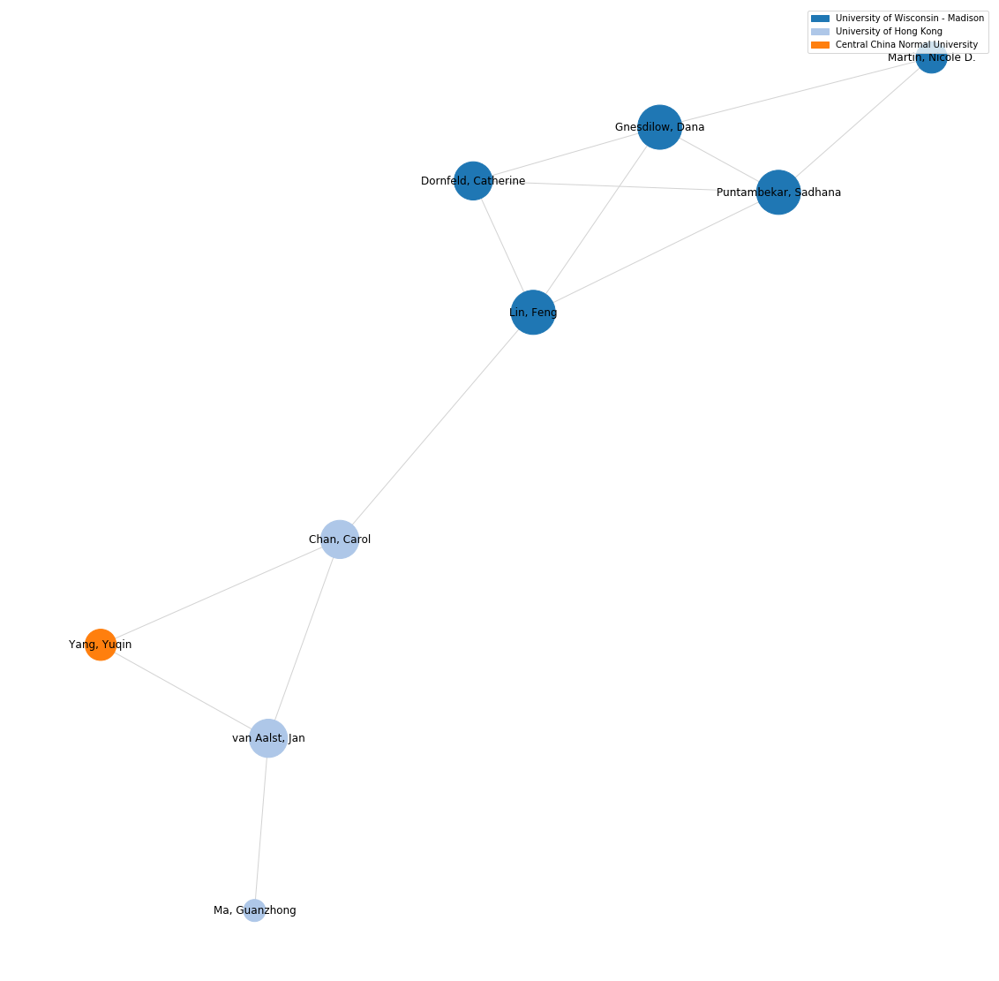

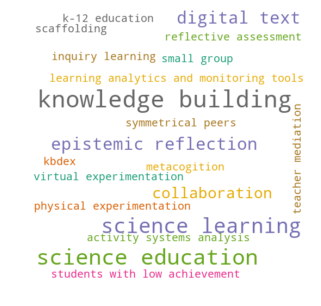

_______
subgraph 11
________


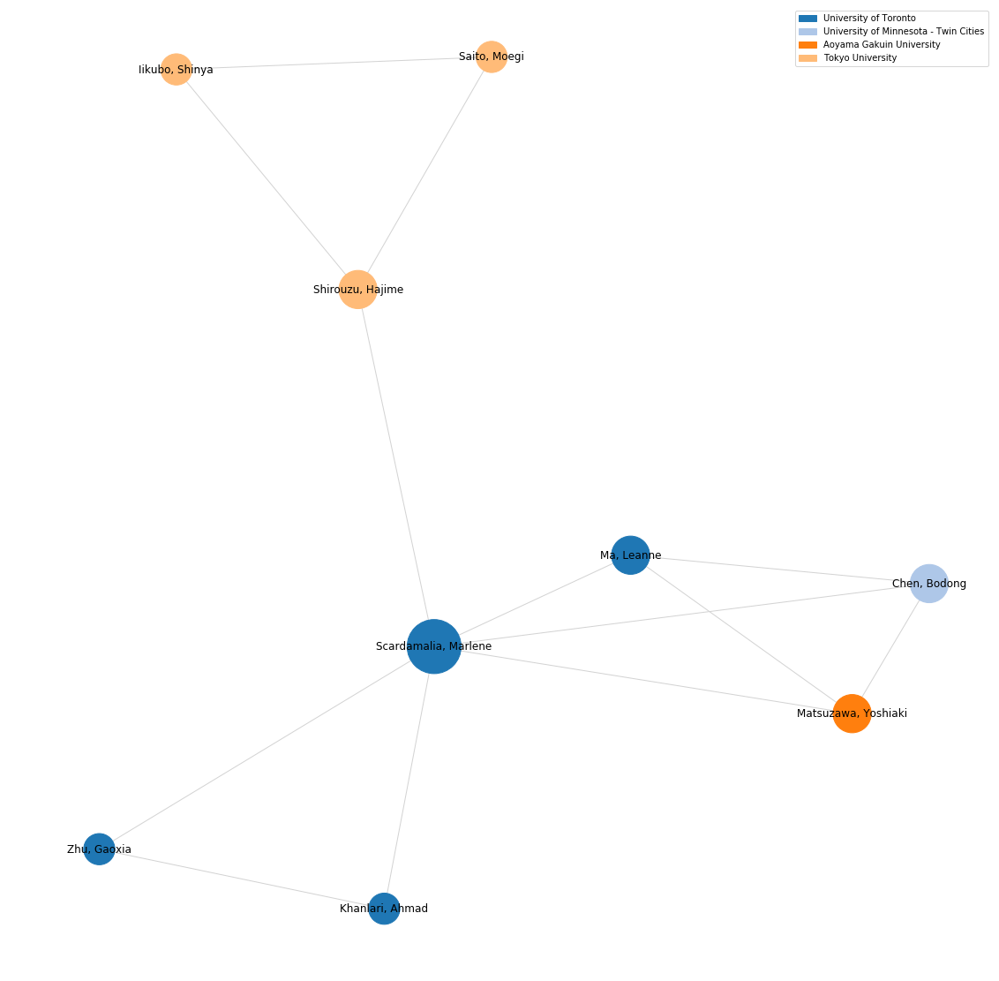

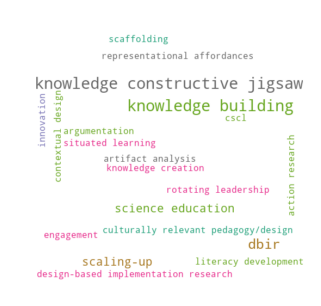

_______
subgraph 12
________


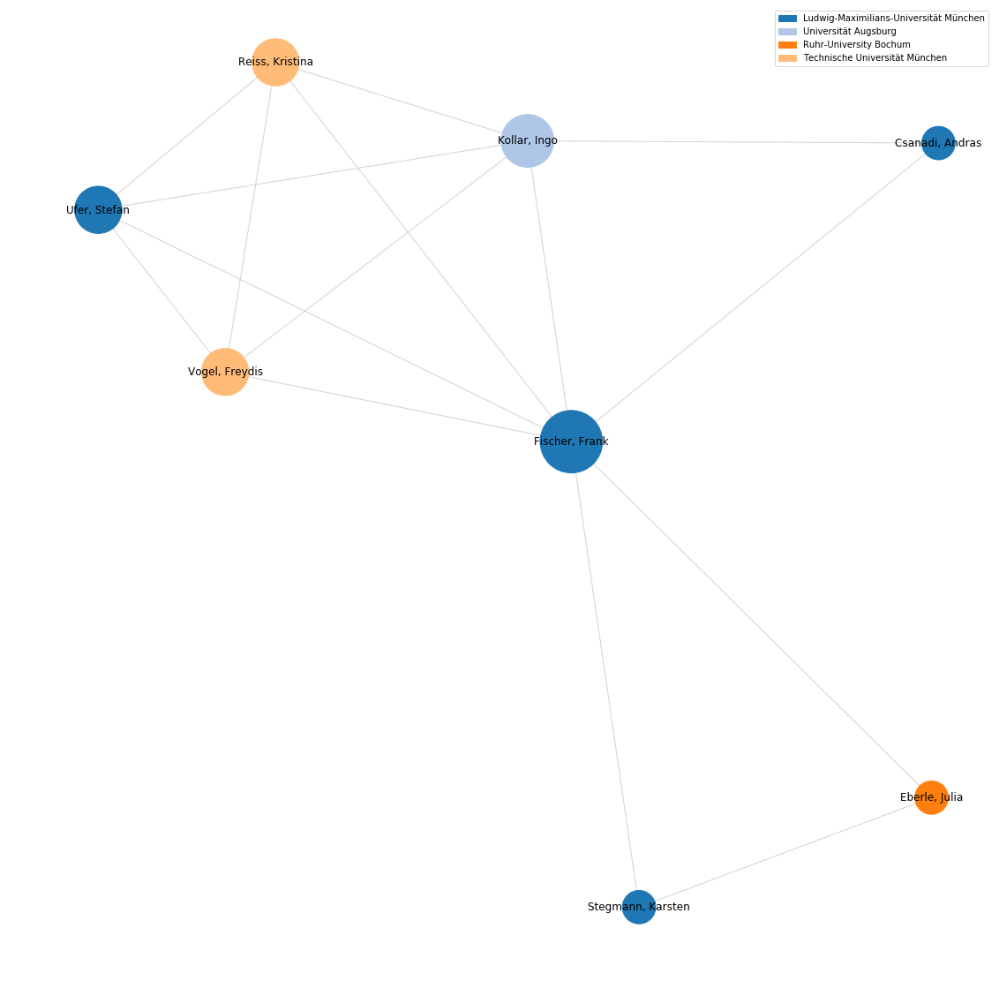

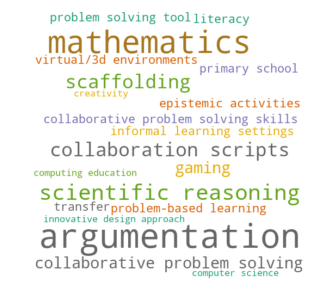

_______
subgraph 13
________


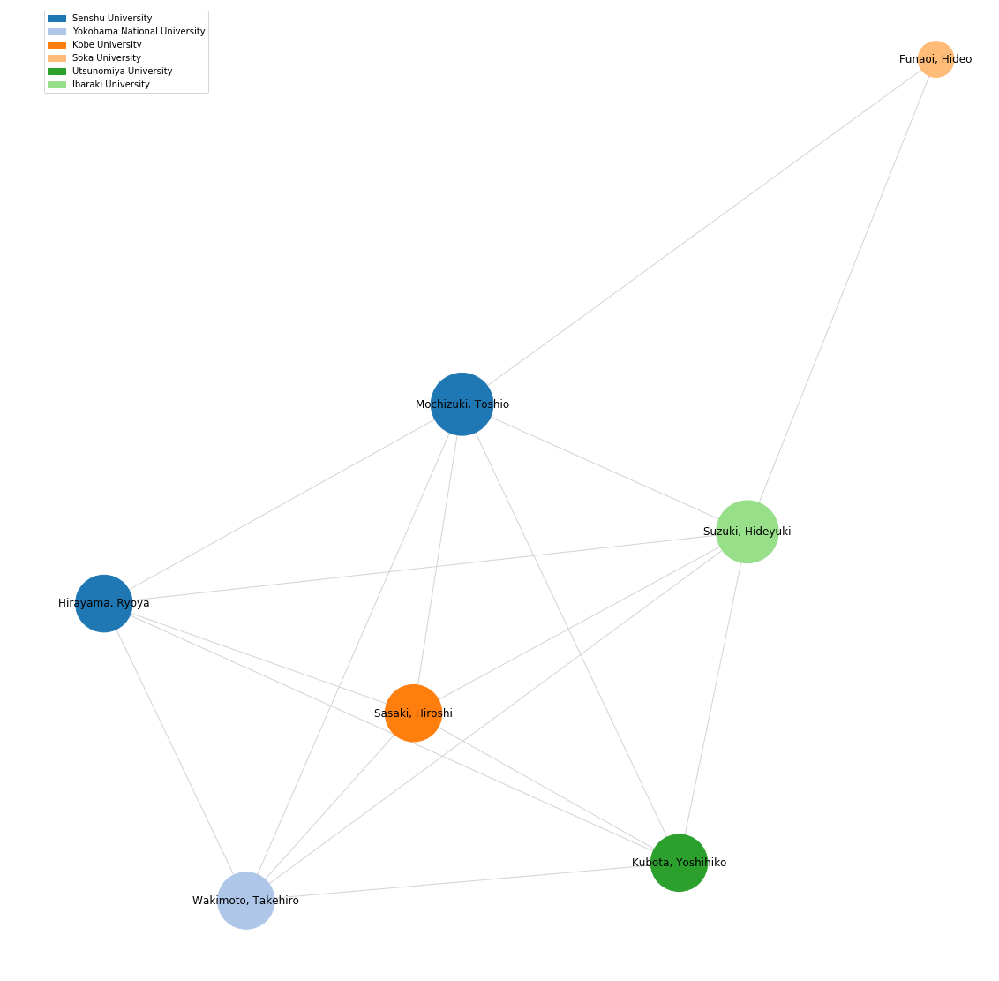

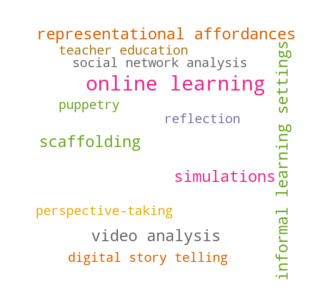

In [59]:
largest_cc_strong = [i for i in list(nx.connected_components(G)) if len(i) > 5]

for i, subgraph in enumerate(largest_cc_strong):
    print('_______\nsubgraph {}\n________'.format(i))
    data = associations[associations.long_name.isin(list(subgraph)) & ~associations.long_name.duplicated()]
    G_ = G.subgraph(subgraph)
    
    helper = list(data.name.unique())
    node_size = np.array(list(nx.degree_centrality(G_).values()))
    node_color = []
    for i in nx.get_node_attributes(G_, 'uni').values():
        node_color.append(palette[helper.index(i)])
#     [palette[helper.index(i)] for i in nx.get_node_attributes(G_, 'uni').values()]
    
    plt.figure(figsize=(15, 15))
    
    nx.draw_spring(G_, node_size=node_size*5000, with_labels=True, edge_color='lightgray', 
                   node_color = node_color, cmap=plt.cm.Set1)

    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    plt.savefig('figures/yearly_subgraph{}'.format(i))
    plt.show()
    
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(subgraph), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=20, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())

    plt.figure(figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud{}.png'.format(i), bbox_inches='tight')
    plt.show()

## collaboration over one years

In [60]:
G = nx.Graph(((source, target, attr) for source, target, attr in graph.edges(data=True) 
              if attr['year'] == 2018 and attr['weight'] > 3))

nx.set_node_attributes(G, nodes.country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.name.to_dict(), name='uni')
nx.set_edge_attributes(G, keyword_dict, name='keywords')
G = nx.relabel_nodes(G,mapping)

largest_cc_strong = max(nx.connected_components(G), key=len)
len(largest_cc_strong)

9

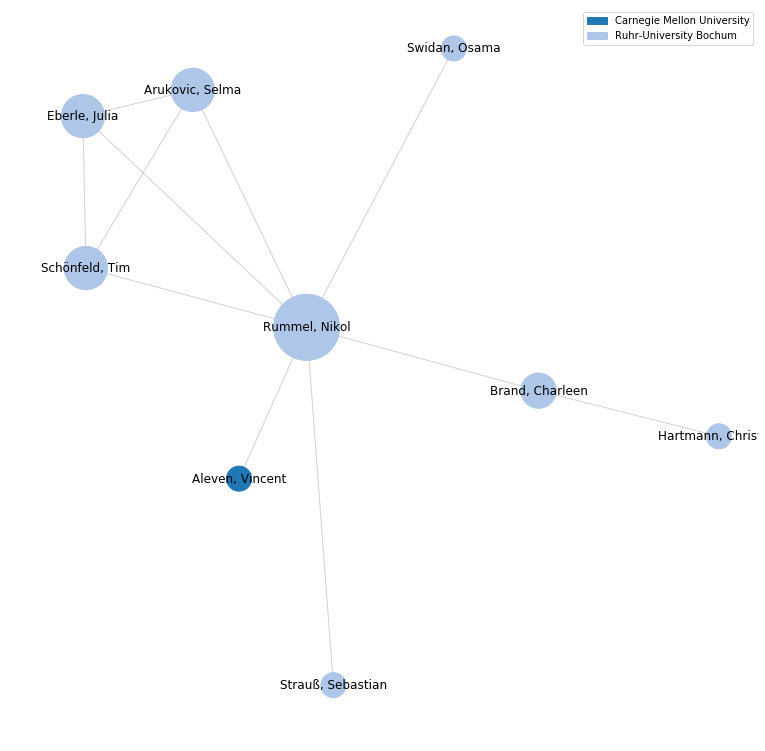

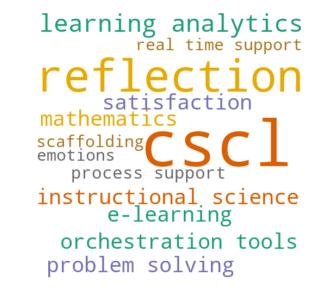

In [61]:
largest_cc_strong = [i for i in list(nx.connected_components(G)) if len(i) > 6]

for subgraph in largest_cc_strong:
    data = associations[associations.long_name.isin(list(subgraph)) & ~associations.long_name.duplicated()]
    G_ = G.subgraph(subgraph)
    
    helper = list(set(nx.get_node_attributes(
        G.subgraph(subgraph), 'uni').values()))
    node_size = np.array(list(nx.degree_centrality(G_).values()))
    node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(G_, 'uni').values()]
    
    plt.figure(figsize=(10, 10))
    
    nx.draw_spring(G_, node_size=node_size*5000, with_labels=True, edge_color='lightgray', 
                   node_color = node_color, cmap=plt.cm.Set1)

    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    plt.show()
    
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(subgraph), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=20, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()

### Who colaborates the most:

We can easely find the people who worked with the most other people:
(counting repeat collaboration)

In [62]:
nodes['collabs_weighted'] = adjacency.sum(axis=1)
nodes.sort_values(by='collabs_weighted', ascending=False)[['long_name', 'country', 'name', 'collabs_weighted']].head(10)

,long_name,country,name,collabs_weighted
138,"Rummel, Nikol",Germany,Ruhr-University Bochum,320
65,"Linn, Marcia",United States,"University of California, Berkeley",202
86,"Puntambekar, Sadhana",United States,University of Wisconsin - Madison,124
73,"Gerard, Libby",United States,"University of California, Berkeley",114
16,"Nathan, Mitchell J.",United States,Arizona State University,109
72,"Vitale, Jonathan M.",United States,"University of California, Berkeley",106
71,"Slotta, James D.",Canada,University of Toronto,105
793,"Enyedy, Noel",United States,"University of California, Los Angeles",104
282,"Kafai, Yasmin B.",United States,University of Pennsylvania,103
792,"Danish, Joshua A.",United States,Indiana University at Bloomington,101


Same as above but counting person only once:

In [63]:
nodes['collabs_unweighted'] = np.where(adjacency > 0, 1, 0).sum(axis=1)
nodes.sort_values(by='collabs_unweighted', ascending=False)[['long_name', 'country', 'name', 'collabs_unweighted']].head(10)

,long_name,country,name,collabs_unweighted
138,"Rummel, Nikol",Germany,Ruhr-University Bochum,84
793,"Enyedy, Noel",United States,"University of California, Los Angeles",71
71,"Slotta, James D.",Canada,University of Toronto,69
309,"Bang, Megan",United States,University of Washington,64
506,"Zhang, Jianwei",United States,State University of New York at Albany,63
282,"Kafai, Yasmin B.",United States,University of Pennsylvania,63
792,"Danish, Joshua A.",United States,Indiana University at Bloomington,62
230,"Kali, Yael",Israel,University of Haifa,62
323,"Fischer, Frank",Germany,Ludwig-Maximilians-Universität München,60
478,"Rosé, Carolyn Penstein",United States,Carnegie Mellon University,60


### Zooming into largest community: - country & institution

In [64]:
main_component = nodes[nodes.index.isin(largest_cc)]

Comparing the country representation in main component to the one overall.

Text(0, 0.5, 'Counts')

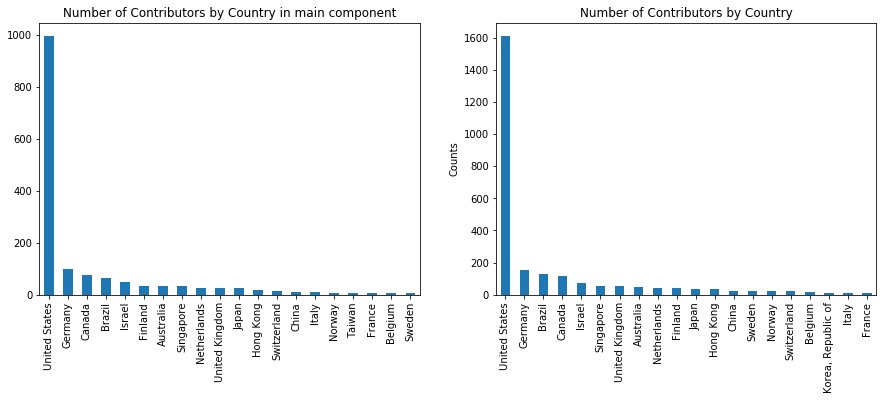

In [65]:
plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.title('Number of Contributors by Country in main component')
main_component.country.value_counts().head(20).plot(kind='bar')
plt.subplot(122)
universities[(~universities.mail.duplicated())].country.value_counts().head(20).plot(kind = 'bar')
plt.title('Number of Contributors by Country') # as determinded by university affiliation
plt.ylabel('Counts')

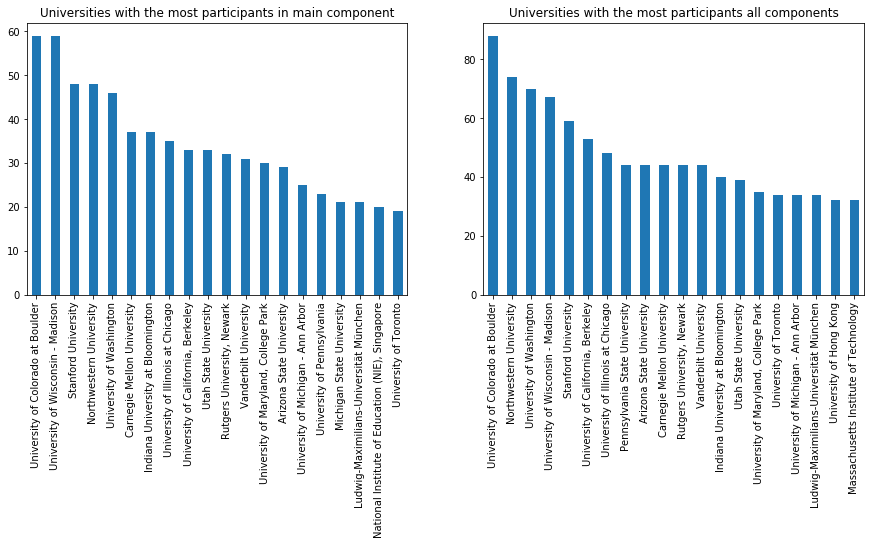

In [66]:
plt.figure(figsize=(15, 5))
plt.subplot(121)
#plt.ylim([0, 60])
plt.title('Universities with the most participants in main component')
main_component.name.value_counts().head(20).plot(kind='bar')
plt.subplot(122)
#plt.ylim([0, 60])
plt.title('Universities with the most participants all components')
universities[(universities.name != 'gmail') & (~universities.mail.duplicated())].name.value_counts().head(20).plot(kind='bar')
plt.show()

## Finding communities in the community: Modularity and Other measures

Constructing the graph with the largest component:

In [67]:
main_component = graph.subgraph(largest_cc)
mapping = nodes.long_name.to_dict()
main_component=nx.relabel_nodes(main_component,mapping)

Here we use modularity to detect communities, which will find subgraph that are unliquely to have developed "randomly".

From wikipedia:

>It was designed to measure the strength of division of a network into modules (also called groups, clusters or communities). Networks with high modularity have dense connections between the nodes within modules but sparse connections between nodes in different modules. Modularity is often used in optimization methods for detecting community structure in networks

In [68]:
c = list(greedy_modularity_communities(main_component))

We find 18 communities in total:

In [69]:
len(c)

33

In [70]:
#smallest community:
min(c, key=len)

frozenset({'Bar-El, David', 'Martin, Kit', 'Worsley, Marcelo'})

## clique detection:


Here we look at large groups of researchers that all have collaborated within eachother.
Only look at connections with weight at least 3 -> at least 3 collaborations, froming a clique of at least 7 people.

In [71]:
mc = nx.from_numpy_array(np.where(nx.to_numpy_array(main_component) >= 2, 1, 0))

main_component_ =nx.relabel_nodes(mc, mapping)
large_cliques = [l for l in list(nx.find_cliques(main_component_)) if len(l) > 6]

large_cliques[0]

['Tissenbaum, Mike',
 'Becker, Sandra',
 'Matuk, Camillia',
 'Zielezinski, Molly B.',
 'McNamara, Danielle S.',
 'Franz, Paul',
 'Li, Yi']

We get a total of 12 groups:

In [72]:
len(large_cliques)

16

In [73]:
main_component_clique = nx.from_numpy_array(nx.to_numpy_array(main_component))

In [74]:
mc = nx.from_numpy_array(np.where(nx.to_numpy_array(main_component_clique) >=2, 1, 0))

In [75]:
large_cliques = [l for l in list(nx.find_cliques(mc)) if len(l) > 6]
color_cliques = {}
set_inclique = set()
for i, clique in enumerate(large_cliques):
    for member in clique:
        color_cliques[member] = i+1
        set_inclique.add(member)

In [76]:
for member in (set(main_component_clique.nodes)-set_inclique):
    color_cliques[member] = 0

Define colormap for better plotting:

   0  ||  1  ||  2  ||  3  ||  4  ||  5  ||  6  ||  7  ||  8  ||  9  ||  10  ||  11  ||  12  ||  13  ||  14  ||  15


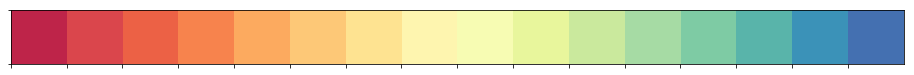

In [77]:
palette = sns.color_palette(palette='Spectral', n_colors=len(large_cliques))

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(len(large_cliques)))]))

In [78]:
colors = ['#C7C7C7'] + \
    sns.color_palette(palette='Spectral', n_colors=30).as_hex()

In [79]:
node_size = (np.array(list(nx.degree_centrality(main_component_clique).values())))
edge_color= np.array(list(nx.get_edge_attributes(main_component_clique, 'weight').values()))

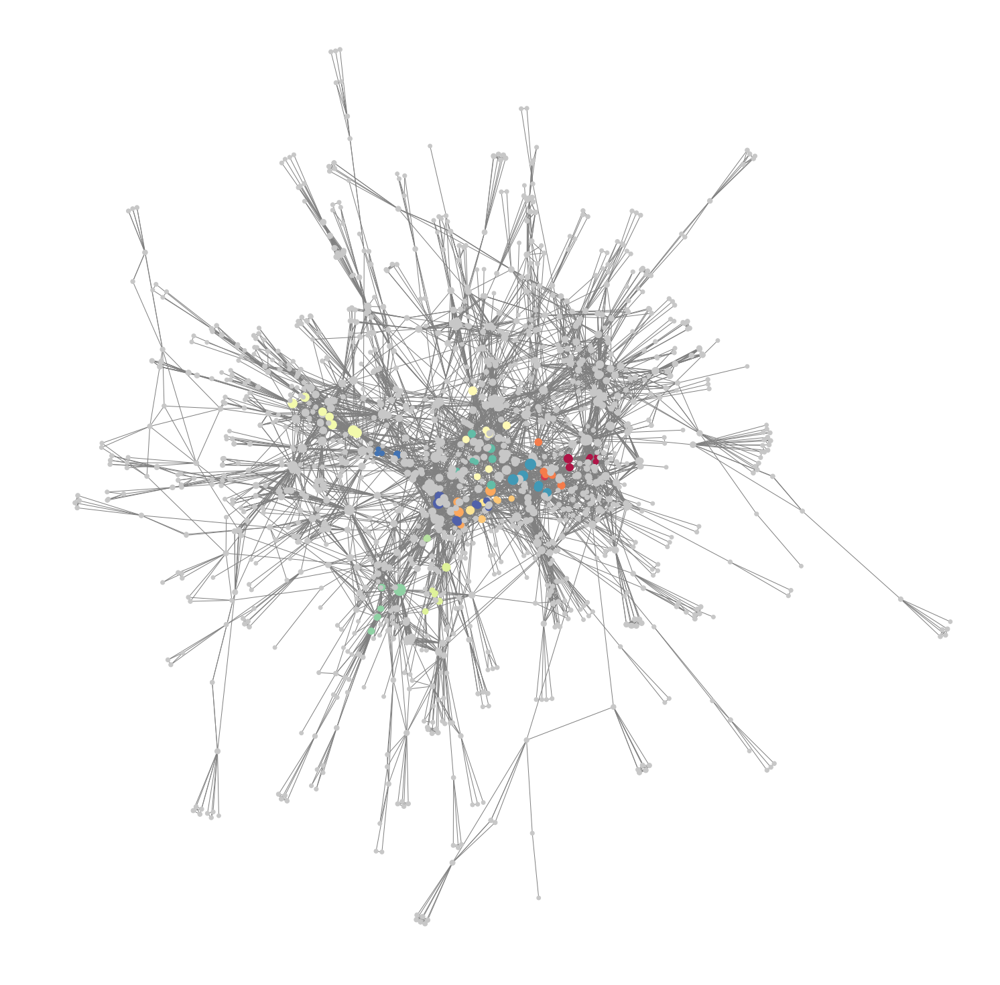

In [80]:
plt.figure(figsize=(20, 20))
nx.draw_spring(main_component_clique, node_color=pd.Series(color_cliques).sort_index().tolist(), 
              cmap=ListedColormap(colors),
              node_size=(node_size+node_size.mean())*5000,
               edge_color='grey',
               iterations=400, seed = 4)

# Using spectral clustering to identify communities:

In [81]:
mapping = nodes.long_name.to_dict()

We change the node size based on degree centrality, the larger the node the more collaborations the individual has:

In [82]:
node_size = np.array(list(nx.betweenness_centrality(main_component).values()))

   1  ||  2  ||  3  ||  4  ||  5  ||  6  ||  7  ||  8  ||  9  ||  10  ||  11  ||  12  ||  13  ||  14  ||  15  ||  16  ||  17  ||  18  ||  19  ||  20  ||  21  ||  22  ||  23  ||  24  ||  25  ||  26


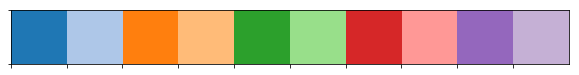

In [83]:
palette = sns.color_palette(palette='tab20', n_colors=10)#len(10)+1)

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 26+1))]))

In [84]:
n_cluster = 10

In [86]:
from sklearn.cluster import SpectralClustering

# Cluster
sc = SpectralClustering(n_cluster, affinity='precomputed', n_init=100, random_state=80)
sc.fit(nx.adj_matrix(main_component))

# Compare ground-truth and clustering-results
print('spectral clustering')
print(pd.Series(sc.labels_).value_counts())

spectral clustering
2    748
0    684
9     46
3     24
1     21
4     20
6     17
8     12
7     11
5      8
dtype: int64


In [87]:
l = pd.Series(sc.labels_)

l[l.map({5: 0, 0: 2, 2:5, 8:6, 6:8}).notna()] = l.map({5: 0, 0: 2, 2:5, 8:6, 6:8})

In [88]:
l.value_counts()

5    748
2    684
9     46
3     24
1     21
4     20
8     17
6     12
7     11
0      8
dtype: int64

In [89]:
pos = nx.layout.spring_layout(main_component, seed=4)

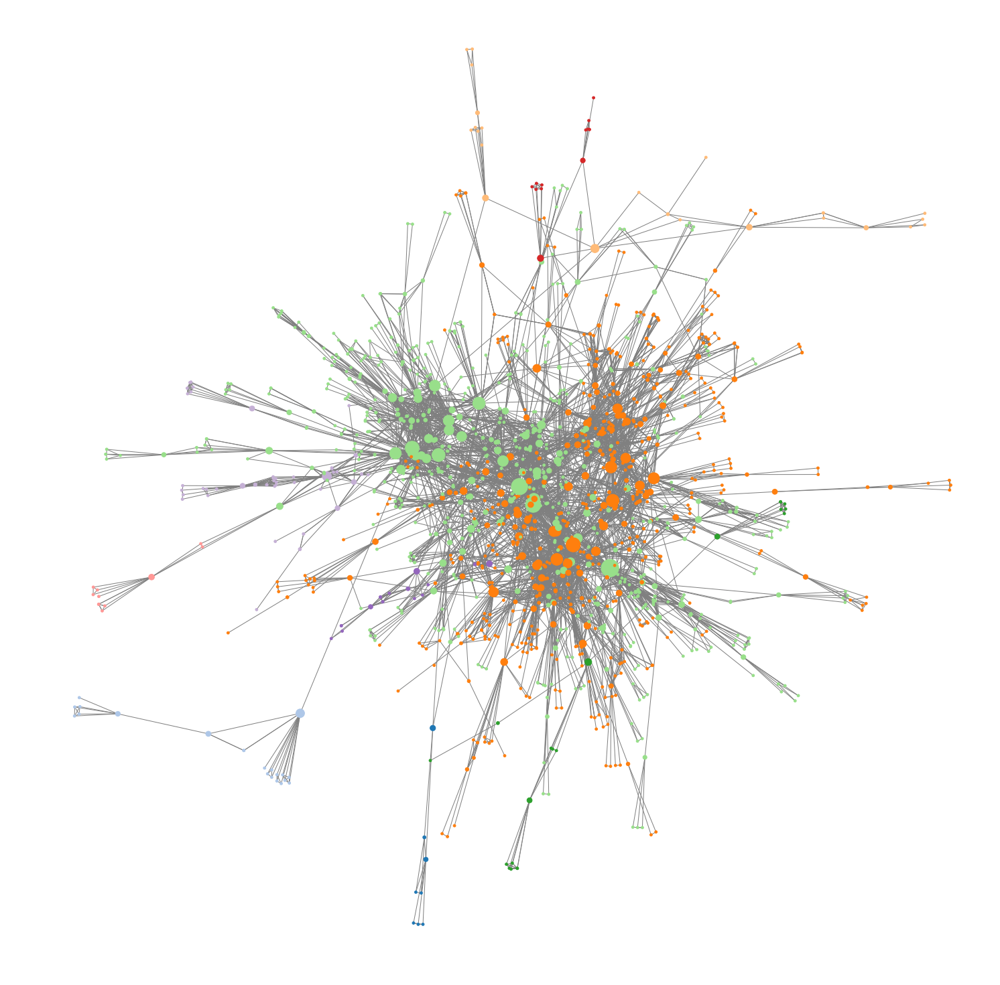

In [90]:
plt.figure(figsize=(20, 20))


nx.draw(main_component,pos=pos, node_color=l.tolist(),#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )
plt.savefig('figures/three_cluster')

In [91]:
nx.write_gpickle(main_component, "main_component.gpickle")

In [92]:
main_component = nx.read_gpickle('main_component.gpickle')

In [93]:
N = main_component.number_of_nodes()
nodes_ = main_component.nodes
E = main_component.edges.keys()

Xv=[pos[k][0] for k in nodes_]
Yv=[pos[k][1] for k in nodes_]

Xed=[]
Yed=[]
for edge in E:
    Xed+=[pos[edge[0]][0],pos[edge[1]][0], None]
    Yed+=[pos[edge[0]][1],pos[edge[1]][1], None] 
    
trace3=Scatter(x=Xed,
               y=Yed,
               mode='lines',
               line=dict(color='rgb(210,210,210)', width=1),
               hoverinfo='none'
               )
trace4=Scatter(x=Xv,
               y=Yv,
               mode='markers',
               name='net',
               marker=dict(symbol='circle-dot',
                             size=node_size*100, 
                             color=l.tolist(),
                             line=dict(color='rgb(50,50,50)', width=0.5)
                             ),
               text=list(nodes_),
               hoverinfo='text'
               )


data1=[trace3, trace4]


layout=Layout(title= "Core of university graph",
    font= dict(size=12),
    showlegend=False,
    autosize=False,
    width=700,
    height=700,      
    hovermode='closest',
    annotations=[
           dict(
           showarrow=False, 
            xref='paper',     
            yref='paper',     
            x=0,  
            y=-0.1,  
            xanchor='left',   
            yanchor='bottom',  
            font=dict(
            size=14 
            )     
            )
        ]          
    )


fig1=Figure(data=data1, layout=layout)
#fig1['layout']['annotations'][0]['text']=annot

iplot(fig1, validate=False)

In [94]:
centrality = nx.betweenness_centrality(main_component)
np.quantile(np.array(list(centrality.values())), 0.9)

0.007375139373099003

In [95]:
#lables = nodes['long_name'].to_dict()

labels = { key: key for (key, value) in centrality.items() if value > 0.03}

node_size = np.array(list(centrality.values()))*5000

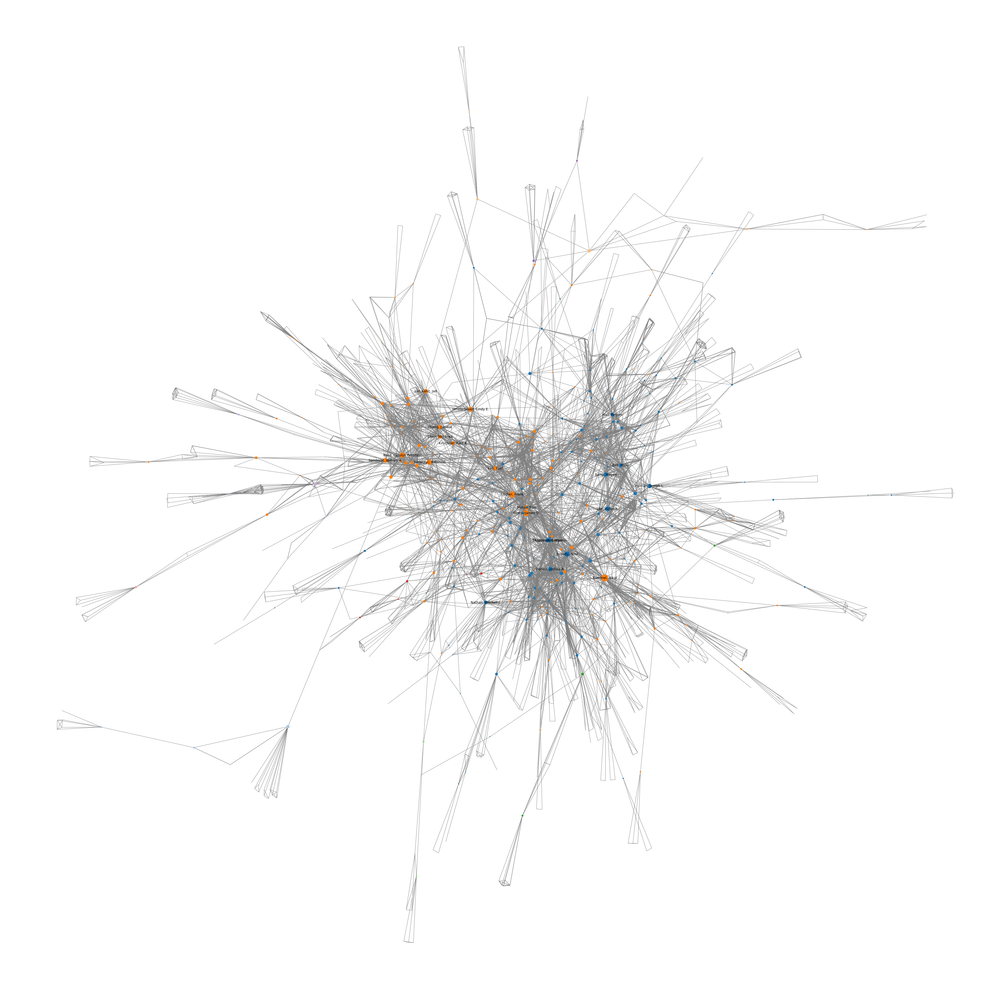

In [96]:
plt.figure(figsize=(50, 50))

nx.draw(main_component,pos=pos, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=node_size,
                       labels=labels,
               edge_color='grey',
       )

In [99]:
from community import community_louvain
partition = community_louvain.best_partition(main_component)
#partition = nx.algorithms.community.greedy_modularity_communities(main_component)
#partition = nx.algorithms.community.asyn_lpa_communities(main_component)

In [100]:
pd.Series(partition).value_counts().mean()

53.03333333333333

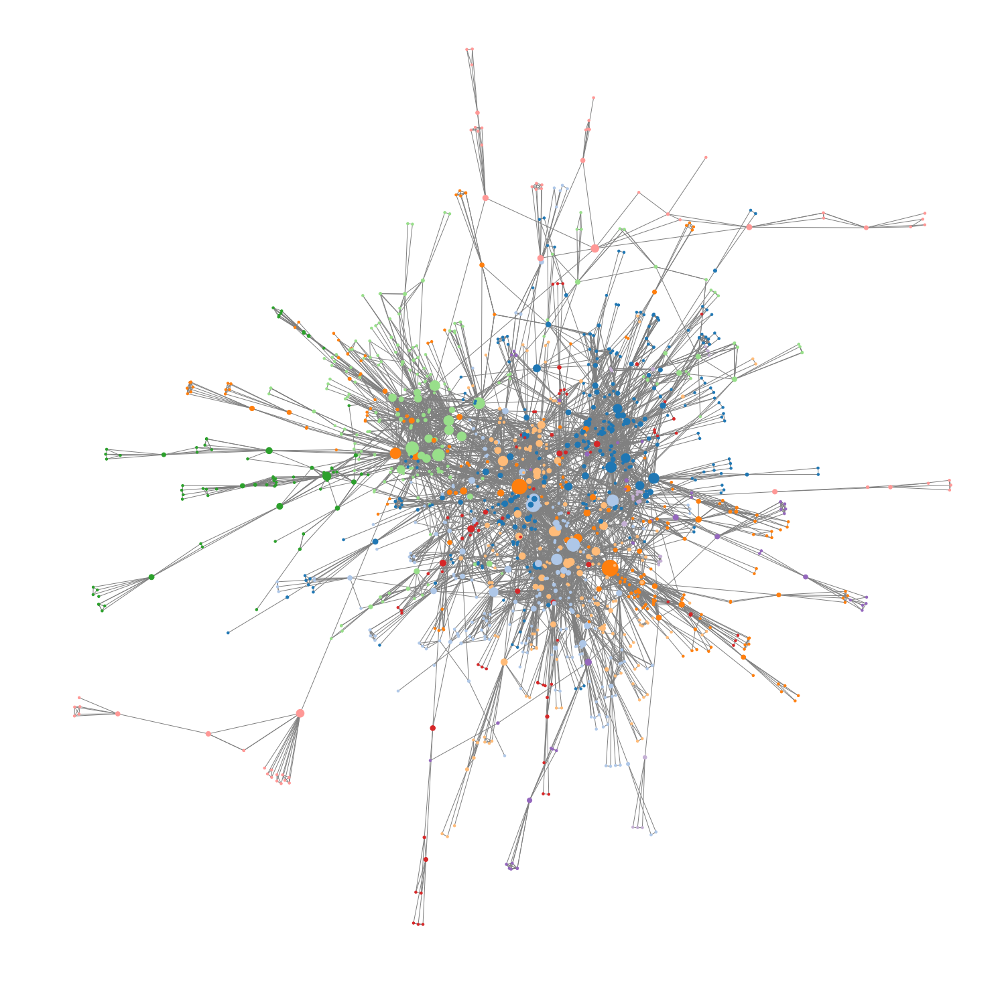

In [101]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, node_color=pd.Series(partition),#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean()),
                       #labels=labels,
               edge_color='grey',
               iterations=10)
plt.savefig('figures/20_cluster')

plotting this geographically, we see that there is no clear geographical clustering belonging to these commuitues!

### Analyzing each subcomponent

We look at distribution of country and inst. inside these clusters (my it's associated members):

Here we have to code that allows to load this graph in Gephi.

In [102]:
df = pd.DataFrame(list(main_component.nodes), columns=['name'])
df['label'] = sc.labels_
df['size'] = node_size
df.head()

,name,label,size
0,"Hinojosa, Leighanna",0,0.017151
1,"Barton, Angela Calabrese",0,25.113694
2,"Tan, Edna",0,0.003958
3,"Shin, Myunghwan",0,0.000000
4,"Ko, Monlin",0,28.344036


In [103]:
c = df.groupby('label').apply(lambda x: set(x['name'].tolist())).tolist()

In [104]:
c = [(i,x) for i,x in enumerate(c) if len(x) > 50]

In [105]:
len(c)

2

As this graph is quite large, we build a smaller graph by cutting off outer nodes, and looking into the connector nodes:

In [106]:
nx.set_node_attributes(main_component, nodes.set_index('long_name').apply(
    lambda x:[x.Lon, x.Lat], axis=1).to_dict(), 'location')

Cluster dist for cluster 1


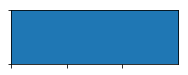

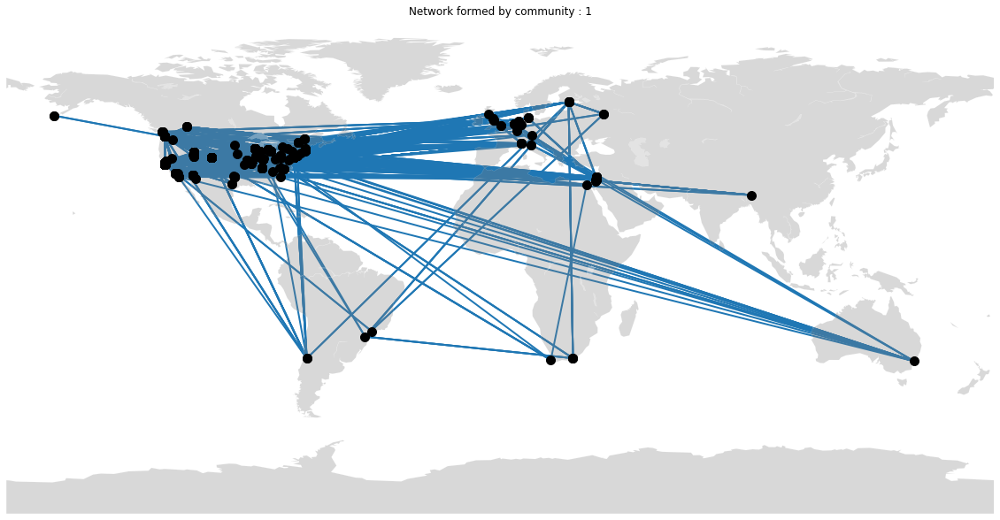

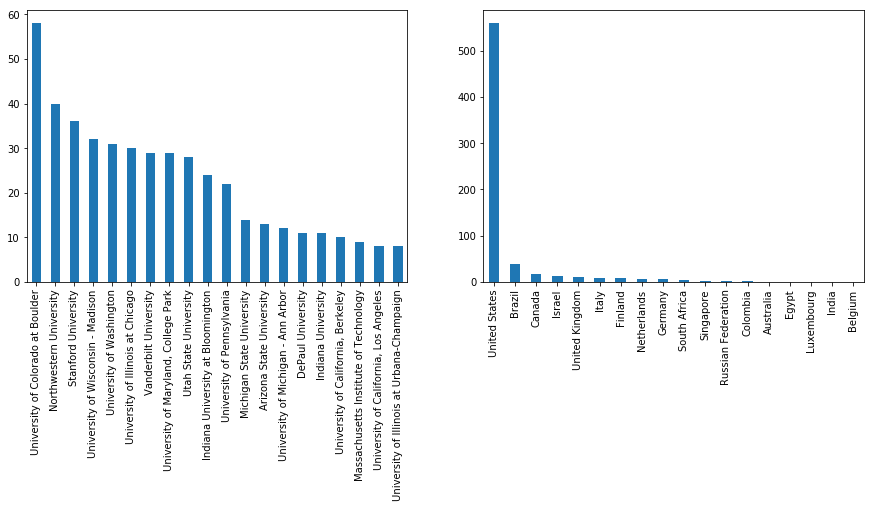

Number of countries in cluster:  18
Number of institutions in cluster:  113
Number of people in cluster:  684


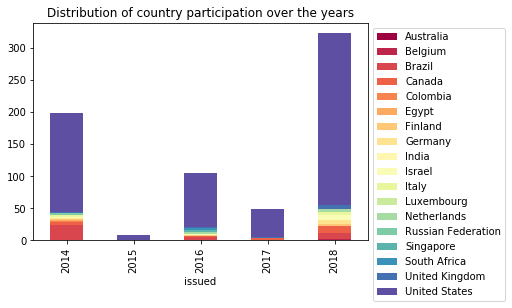

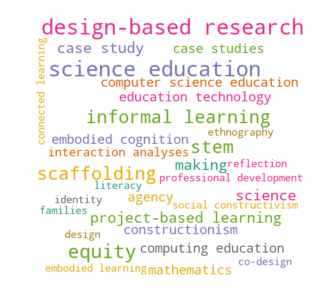

                      centrality
0                               
Enyedy, Noel            0.150871
Bang, Megan             0.121331
Bell, Philip            0.094416
Kafai, Yasmin B.        0.092641
Severance, Samuel       0.077300
Lee, Victor R.          0.067898
Hall, Rogers            0.059157
Shapiro, R. Benjamin    0.057035
Levy, Sharona           0.055259
Sengupta, Pratim        0.054655
Cluster dist for cluster 3


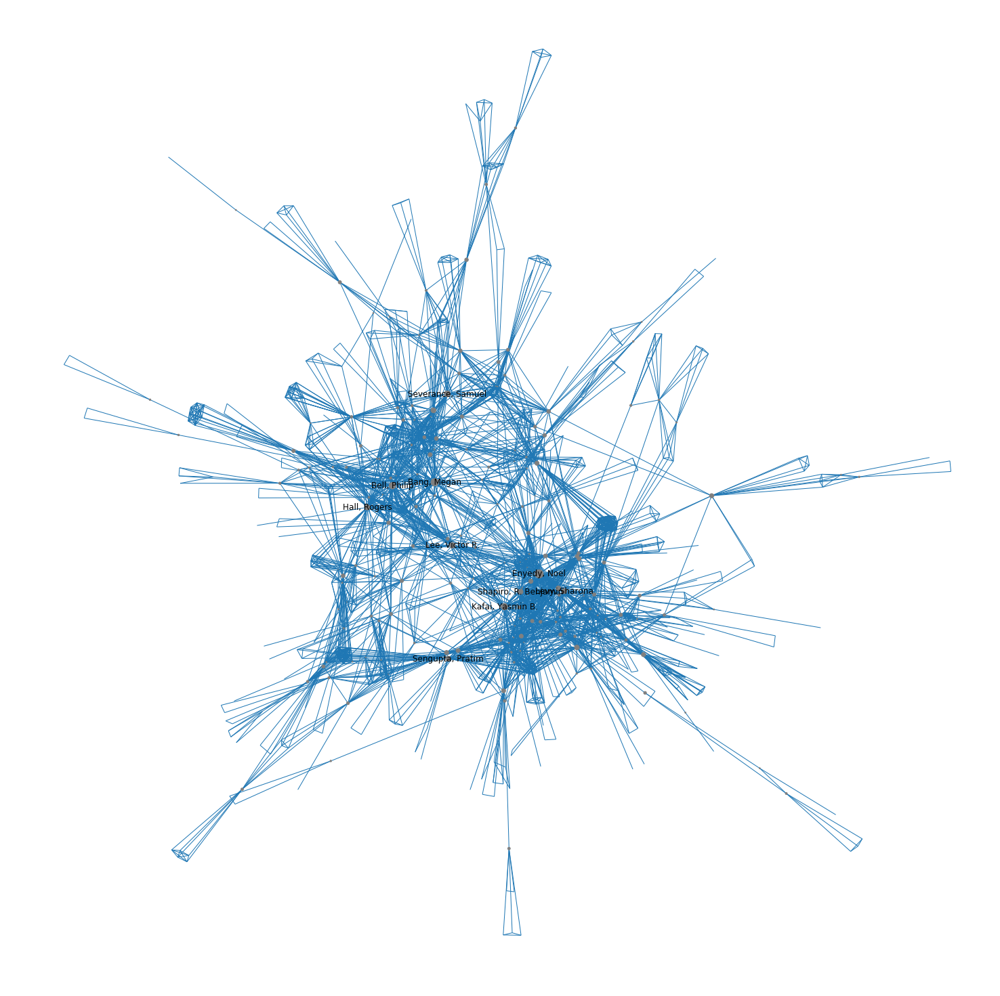

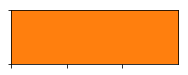

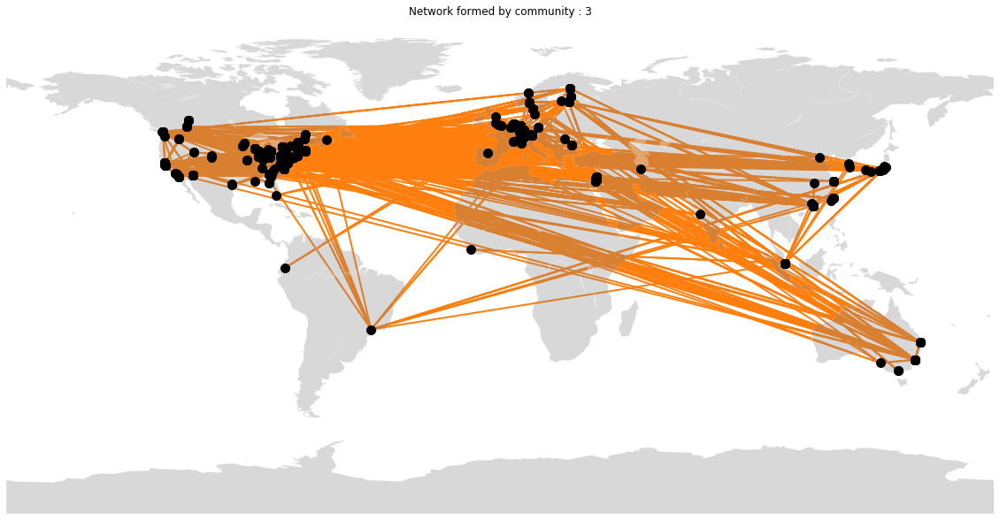

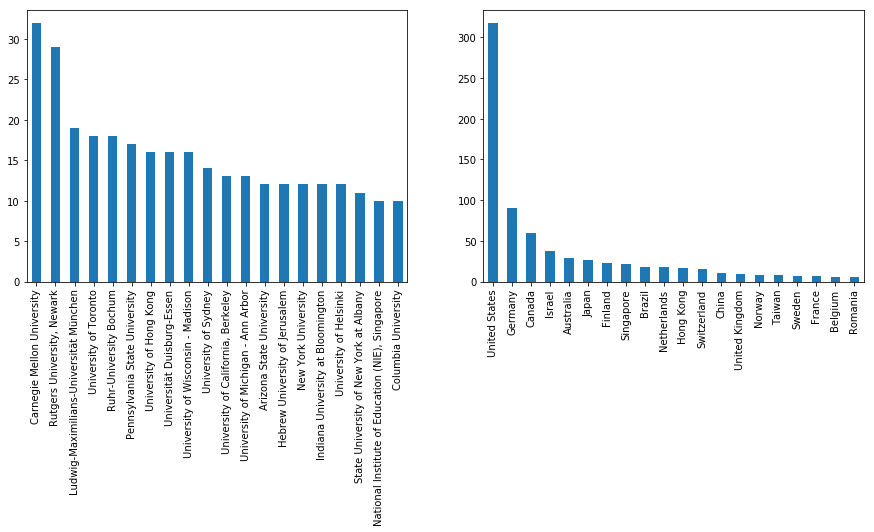

Number of countries in cluster:  30
Number of institutions in cluster:  182
Number of people in cluster:  748


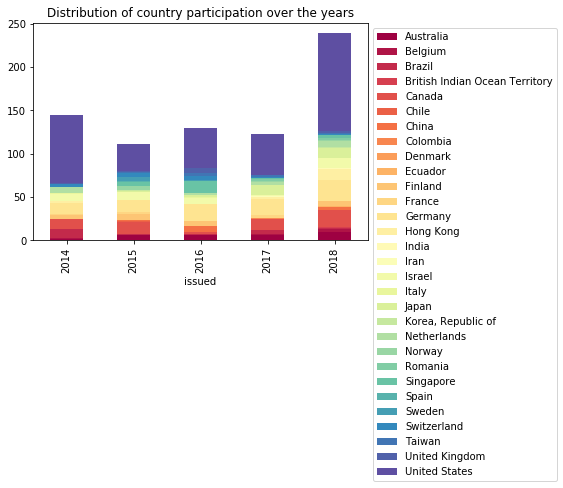

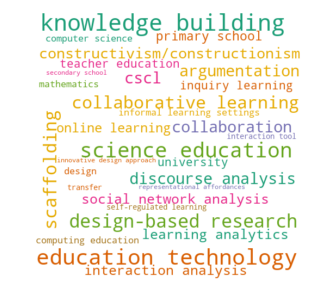

                         centrality
0                                  
Rummel, Nikol              0.251917
Fischer, Frank             0.250221
Slotta, James D.           0.104383
Rosé, Carolyn Penstein    0.098133
Zhang, Jianwei             0.072599
Kirschner, Paul A.         0.068846
Clarke, Sherice            0.062257
Chan, Carol                0.057280
McNamara, Danielle S.      0.055205
Sandoval, William A.       0.053290


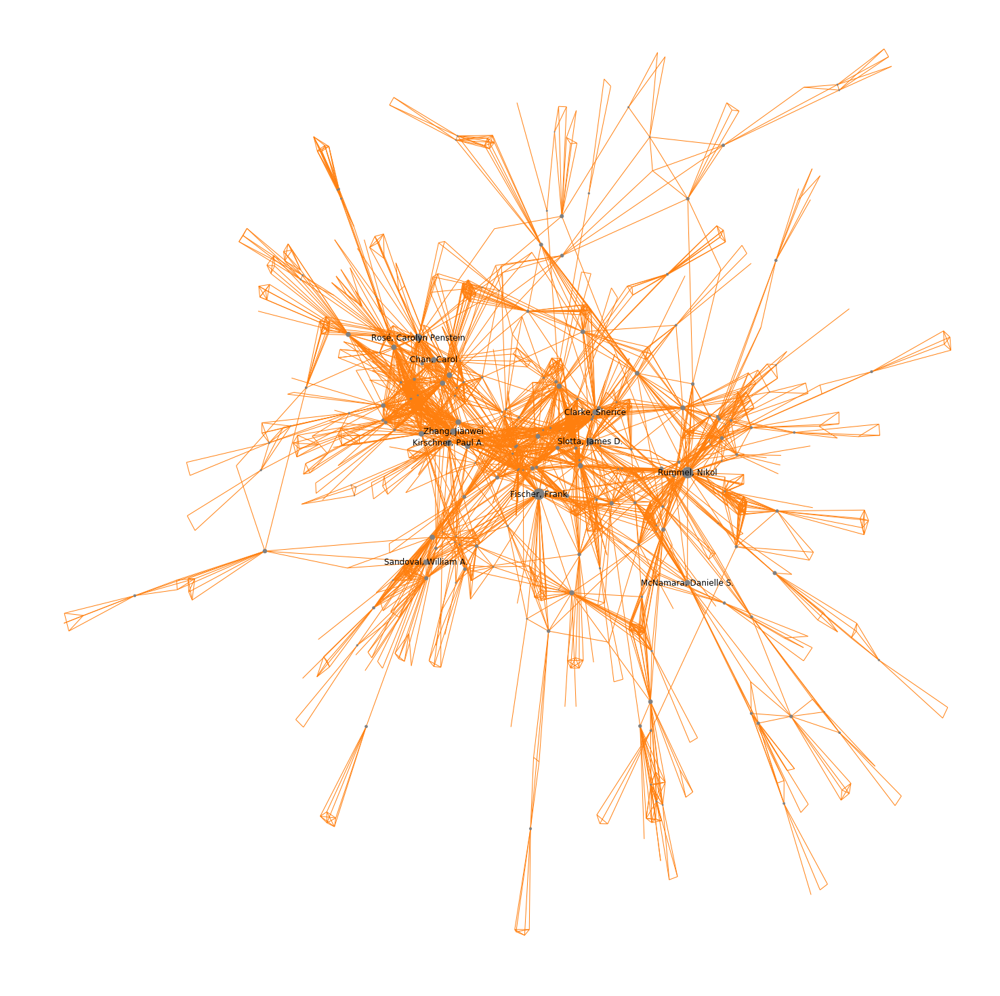

In [107]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt

for i, cluster in c:
    print('Cluster dist for cluster {}'.format(i+1))
    sns.palplot(palette[i])
    
    plt.figure(figsize=(20, 20))
    #draw_map_plot(data, palette.as_hex()[i])

    comp = main_component.subgraph(cluster)
    embedding = nx.get_node_attributes(comp, 'location')
        
    m=Basemap()
    m.drawmapboundary(linewidth=0)
    m.fillcontinents(color='grey', alpha=0.3)
    m.drawcoastlines(linewidth=0.1, color="white")
    node_size = 1 #np.array(list(nx.betweenness_centrality(main_component.subgraph(cluster)).values()))
    nx.draw(comp,  
            pos = nx.get_node_attributes(comp, 'location'), 
            node_size= node_size*100,
            edge_color=palette.as_hex()[i],
            node_color='black',
            width = 2)
    
    plt.title('Network formed by community : {}'.format(i+1))
    plt.show()
    
    #adding inner cluster distribution plot
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    nodes[nodes.long_name.isin(cluster)].name.value_counts().head(20).plot('bar')
    plt.subplot(122)
    nodes[nodes.long_name.isin(cluster)].country.value_counts().head(20).plot('bar')
    plt.show()
    
    #getting some concrete values
    print('Number of countries in cluster: ', len(nodes[nodes.long_name.isin(cluster)].country.unique()))
    print('Number of institutions in cluster: ', len(nodes[nodes.long_name.isin(cluster)].name.unique()))
    print('Number of people in cluster: ', len(nodes[nodes.long_name.isin(cluster)].long_name.unique()))
    
    #plt.title('Number of people submitting over the years over the years')
    
   
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show()    
    
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('figures/wordcloud_commuity{}.png'.format(i), bbox_inches='tight')
    plt.show()
    
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(10)
    print(labels.set_index(0))
    
    layout = nx.drawing.layout.spring_layout(comp, scale=3)
    labels['n']  = labels[0]
    labels = labels.set_index(0).n.to_dict()
    plt.figure(figsize=(20, 20))
    nx.draw(comp, pos=layout,
            node_size=node_size*1000,
            edge_color=palette.as_hex()[i],
            node_color='grey',
            width = 1, labels=labels)

## Looking at people moving around

We now look at people who moved from one country to an other within the period of the papers in the parsed papers:

We have to look at years as well to avoid duplicates, however, this could be due to people being associated to multiple institutions at once.

In [108]:
name_country = associations[['name', 'mail', 'country', 'long_name', 'shortend_names','issued']]

In [109]:
#Add year to see
df = pd.merge(name_country, name_country, on='long_name').dropna()
df = df[df.shortend_names_x == df.shortend_names_y]
df = df[df.country_x != df.country_y]
df = df[df.issued_x <= df.issued_y]
df = df[~df[['long_name','name_x', 'name_y']].duplicated()]
df

,name_x,mail_x,country_x,long_name,shortend_names_x,issued_x,name_y,mail_y,country_y,shortend_names_y,issued_y
213,Hong Kong Institute of Education,mkapur@ied.edu.hk,Hong Kong,"Kapur, Manu",Kapur M.,2016,University of Sydney,peter.reimann@sydney.edu.au,Australia,Kapur M.,2018
215,Hong Kong Institute of Education,mkapur@ied.edu.hk,Hong Kong,"Kapur, Manu",Kapur M.,2016,"National Institute of Education (NIE), Singapore",layhoon.seah@nie.edu.sg,Singapore,Kapur M.,2016
218,"National Institute of Education (NIE), Singapore",layhoon.seah@nie.edu.sg,Singapore,"Kapur, Manu",Kapur M.,2016,University of Sydney,peter.reimann@sydney.edu.au,Australia,Kapur M.,2018
219,"National Institute of Education (NIE), Singapore",layhoon.seah@nie.edu.sg,Singapore,"Kapur, Manu",Kapur M.,2016,Hong Kong Institute of Education,mkapur@ied.edu.hk,Hong Kong,Kapur M.,2016
237,University of Sydney,peter.reimann@sydney.edu.au,Australia,"Reimann, Peter",Reimann P.,2015,ETHZ - ETH Zurich,manukapur@ethz.ch,Switzerland,Reimann P.,2018
554,"Ohio State University, Columbus",sun.272@osu.edu,United States,"Sun, Zhiru",Sun Z.,2015,University of Southern Denmark - SDU,zhiru@sam.sdu.dk,Denmark,Sun Z.,2016
1250,Ludwig-Maximilians-Universität München,Sandra.Becker@psy.lmu.de,Germany,"Becker, Sandra",Becker S.,2016,University of Calgary,sandra.becker@ucalgary.ca,Canada,Becker S.,2018
1325,University of Toronto,mike.tissenbaum@utoronto.ca,Canada,"Tissenbaum, Mike",Tissenbaum M.,2014,University of Pennsylvania,miketissenbaum@gmail.com,United States,Tissenbaum M.,2016
1335,University of Pennsylvania,miketissenbaum@gmail.com,United States,"Tissenbaum, Mike",Tissenbaum M.,2014,University of Toronto,mike.tissenbaum@utoronto.ca,Canada,Tissenbaum M.,2014
2821,University of Toronto,jslotta@gmail.com,Canada,"Slotta, James D.",Slotta J. D.,2016,Boston College,slotta@bc.edu,United States,Slotta J. D.,2017


we can see that within 4 years, a total of 20 repeat participants moved to universities in different countries!

In [110]:
df.long_name.drop_duplicates().shape

(49,)

In [111]:
new_homes = set(df.name_x).union(set(df.name_y))
len(new_homes)

55

In [112]:
len(set(df.name_y))

46

In [113]:
movement_graph = nx.from_pandas_edgelist(df, source='name_x', 
                                         target='name_y', edge_attr=['long_name', 'issued_y'],
                                        create_using=nx.DiGraph)
names = list(movement_graph.nodes)

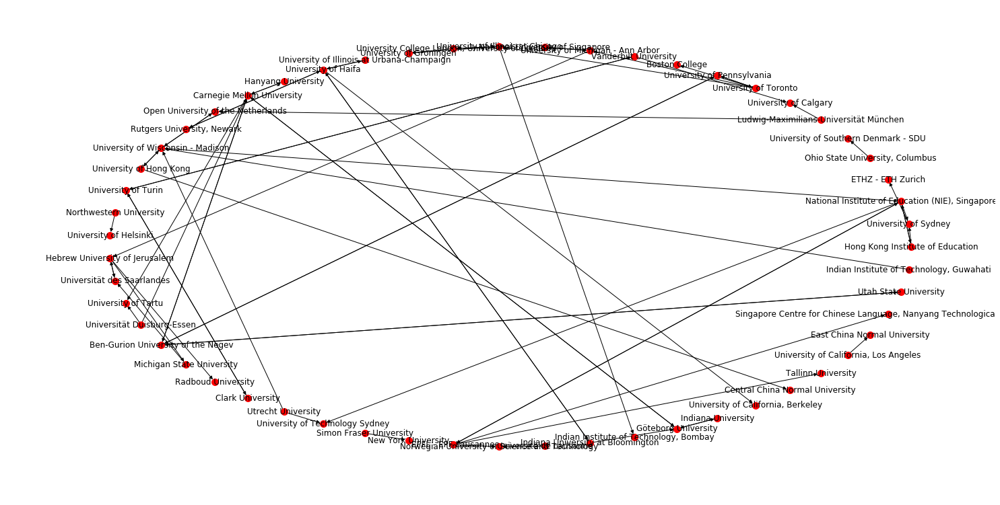

In [114]:
plt.figure(figsize=(20, 10))
nx.draw_circular(movement_graph, node_size=100,
                 labels=pd.DataFrame(names, names).to_dict()[0], 
                )

a total of 70 people change university overall all

In [115]:
#Add year to see
name_country = associations[associations.Lat.notna()][['name', 'mail', 'country', 'long_name', 'shortend_names','issued']]
df = pd.merge(name_country, name_country, on='long_name').dropna()
df = df[df.shortend_names_x == df.shortend_names_y]
df = df[df.name_x != df.name_y]
df = df[df.issued_x <= df.issued_y]
df = df[~df[['long_name','name_x', 'name_y']].duplicated()]
df.long_name.drop_duplicates().shape

(147,)

In [116]:
new_homes = set(df.name_x).union(df.name_y)
len(new_homes)

117

In [117]:
movement_graph = nx.from_pandas_edgelist(df, 
                                         source='name_x', 
                                         target='name_y', 
                                         edge_attr=['long_name', 'issued_y'], 
                                         create_using=nx.DiGraph)


In [118]:
name_loc_mapping = pd.DataFrame(associations[associations.name.isin(new_homes) & ~associations.name.duplicated()].name.copy())

In [119]:
name_loc_mapping['loc'] = associations[associations.name.isin(new_homes) & ~associations.name.duplicated()
                                      ].apply(lambda x: np.array([x.Lon, x.Lat]) , axis=1)

In [120]:
name_loc_mapping = name_loc_mapping.set_index('name')['loc'].to_dict()

In [121]:
nx.set_node_attributes(movement_graph,name_loc_mapping, 'pos')

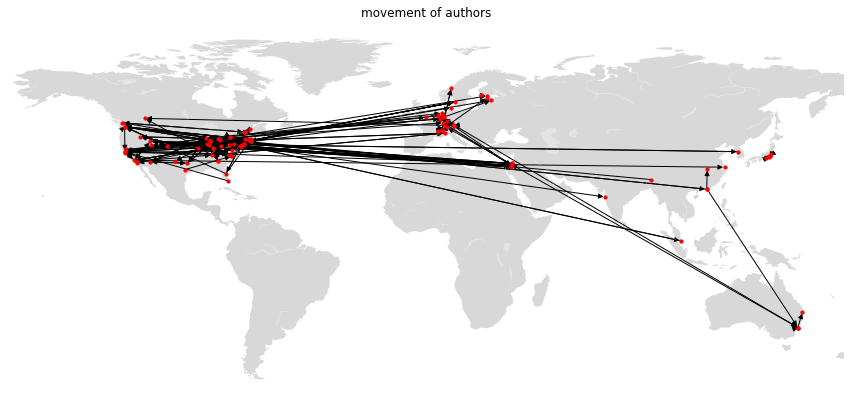

In [122]:
#
names = list(movement_graph.nodes)

plt.figure(figsize=(15, 10))
plt.title('movement of authors')
m=Basemap(llcrnrlon=-170,urcrnrlon=170,llcrnrlat=-60,urcrnrlat=90)
m.drawmapboundary(linewidth=0)
m.fillcontinents(color='grey', alpha=0.3)
m.drawcoastlines(linewidth=0.1, color="white")
nx.draw(movement_graph, node_size=10,
        #labels=pd.DataFrame(names, names).to_dict()[0], 
        pos=nx.get_node_attributes(movement_graph, 'pos'),
        k = 1000)
plt.savefig('figures/movement_map')

## Looking at the network over the years

One interessting observation is that the ICLS years are much more dense and connected.

In [123]:
associations.issued.unique()

array([2018, 2016, 2014, 2017, 2015])

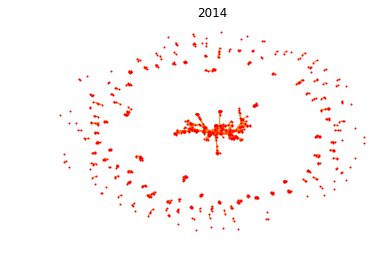

Density of the graph :  0.006674180042293034
The largest component has  289 nodes accounting for 35.55 % of the nodes
The diameter of the largest component is 11
The clustering coeff of is 0.7510879742598019


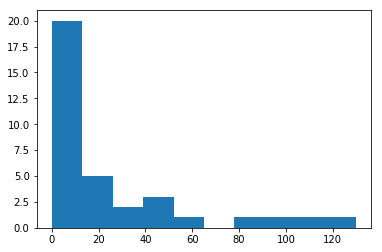

The average shortest path length in the main component is :  4.8761053440984234
Attribute Assortativity coef: Country:  0.3689886202308689
Attribute Assortativity coef: Uni:  0.27808078698088795
1      41
2      37
3      23
4      17
5      10
6      12
7       4
8       3
9       2
10      1
11      3
12      2
13      1
289     1
dtype: int64


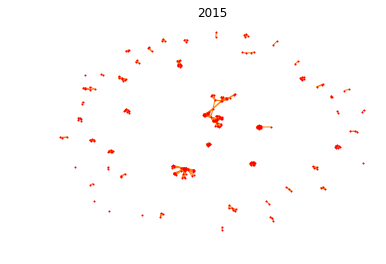

Density of the graph :  0.02270505976994211
The largest component has  58 nodes accounting for 20.49 % of the nodes
The diameter of the largest component is 6
The clustering coeff of is 0.8206815832356651


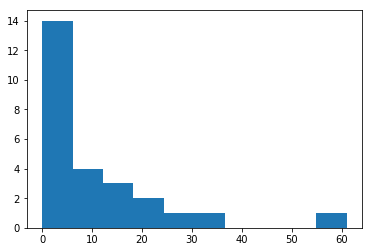

The average shortest path length in the main component is :  2.8650937689050213
Attribute Assortativity coef: Country:  0.47868031867842536
Attribute Assortativity coef: Uni:  0.35148005382356395
1      6
2     12
3     14
4      3
5      2
6      4
7      3
9      1
10     1
12     1
19     1
36     1
58     1
dtype: int64


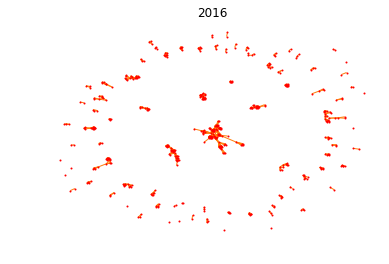

Density of the graph :  0.011612862507494714
The largest component has  102 nodes accounting for 20.24 % of the nodes
The diameter of the largest component is 7
The clustering coeff of is 0.8269559636040804


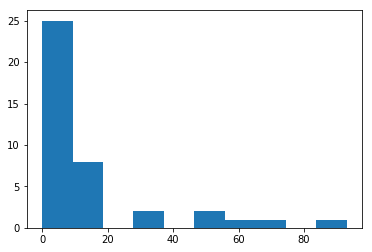

The average shortest path length in the main component is :  2.945835760046593
Attribute Assortativity coef: Country:  0.47027175566128093
Attribute Assortativity coef: Uni:  0.3742183166858114
1      11
2      17
3      22
4       6
5       9
6       3
7       3
8       1
9       2
10      2
13      1
16      2
17      1
20      2
35      1
102     1
dtype: int64


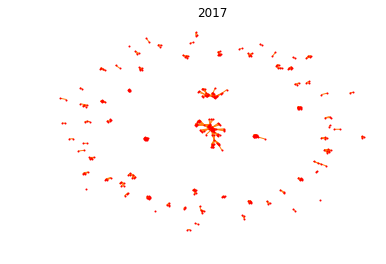

Density of the graph :  0.016784086199751348
The largest component has  79 nodes accounting for 20.73 % of the nodes
The diameter of the largest component is 6
The clustering coeff of is 0.7985428544858156


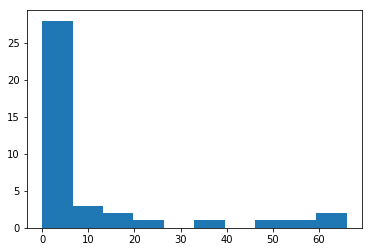

The average shortest path length in the main component is :  2.6845180136319375
Attribute Assortativity coef: Country:  0.38866551860348103
Attribute Assortativity coef: Uni:  0.2851934406668711
1      4
2     21
3     13
4      8
5     10
6      4
7      4
8      1
10     1
13     1
18     1
34     1
79     1
dtype: int64


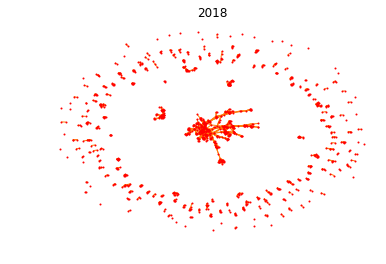

Density of the graph :  0.005512429866610113
The largest component has  414 nodes accounting for 36.54 % of the nodes
The diameter of the largest component is 12
The clustering coeff of is 0.7689669761056661


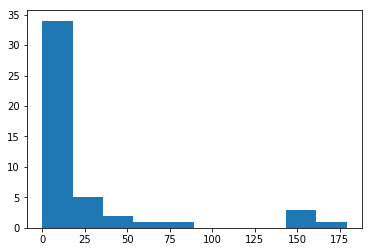

The average shortest path length in the main component is :  5.057456340433496
Attribute Assortativity coef: Country:  0.45091578685373807
Attribute Assortativity coef: Uni:  0.30871907696232936
1      41
2      53
3      35
4      21
5      22
6      10
7       7
8       1
9       2
10      3
11      2
19      1
24      1
43      1
414     1
dtype: int64


In [124]:
for year in sorted(associations.issued.unique()):

    
    #getting the data in shape to build the graph
    year_assoc = associations[(associations.country.notna()) & (associations.issued==year)]

    self_merge = pd.merge(year_assoc, year_assoc, on='file')
    self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]


    nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
    name_index = nodes.long_name.to_dict()
    name_index = {v: k for k, v in name_index.items()}

    self_merge['source'] = self_merge.long_name_x.map(name_index)
    self_merge['target'] = self_merge.long_name_y.map(name_index)

    #building the graph
    adjacency = get_adjacency(nodes, self_merge)
    graph = nx.from_numpy_array(adjacency)

    #plot the map
    #plt.figure(figsize=(20, 20))
    plt.title(year)
    data = nodes.copy()
    #draw_map_plot(data, palette.as_hex()[i])


    #add the graph on top
    embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)
    nx.draw(graph,  #pos = embedding, 
                           edge_color=palette.as_hex()[i], width = 1, node_size=1)
    plt.show()   
    
    
    #calculate graph theoretical measures
    nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
    nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
    nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

    print('Density of the graph : ' , nx.density(graph))
    comp = list(nx.connected_components(graph))
    largest_comp = max(comp, key=len)
    percentage_lcc = len(largest_comp)/ graph.number_of_nodes() * 100
    print('The largest component has ',
          len(largest_comp), 'nodes',
          'accounting for %.2f'% percentage_lcc, 
          '% of the nodes')
    lcc = graph.subgraph(largest_comp)
    diameter = nx.diameter(lcc)
    print("The diameter of the largest component is", diameter)
    print("The clustering coeff of is",nx.average_clustering(graph))
    plt.hist(nx.degree_histogram(graph))
    plt.show()
    print("The average shortest path length in the main component is : " ,nx.average_shortest_path_length(lcc) )
    print('Attribute Assortativity coef: Country: ', nx.attribute_assortativity_coefficient(graph, 'country'))
    print('Attribute Assortativity coef: Uni: ', nx.attribute_assortativity_coefficient(graph, 'uni'))
    print(pd.Series([len(i) for i in comp]).value_counts().sort_index())

From the above we can deduce that:
1. the community is becomming less tight knit by the year (Density of graph, Diameter, Largest component)
2. something weird is going on in 2017, why is largest commponent so smal
3. There seems to be no string geographical linkage (country/uni) for collaboration (Attribute Assorativity Coefficient), which gives us how likely two nodes are linked given that they have the same attribute (country/uni)

## ICLS vs CSCL:

In [125]:
(associations.issued % 2 == 1).sum()

880

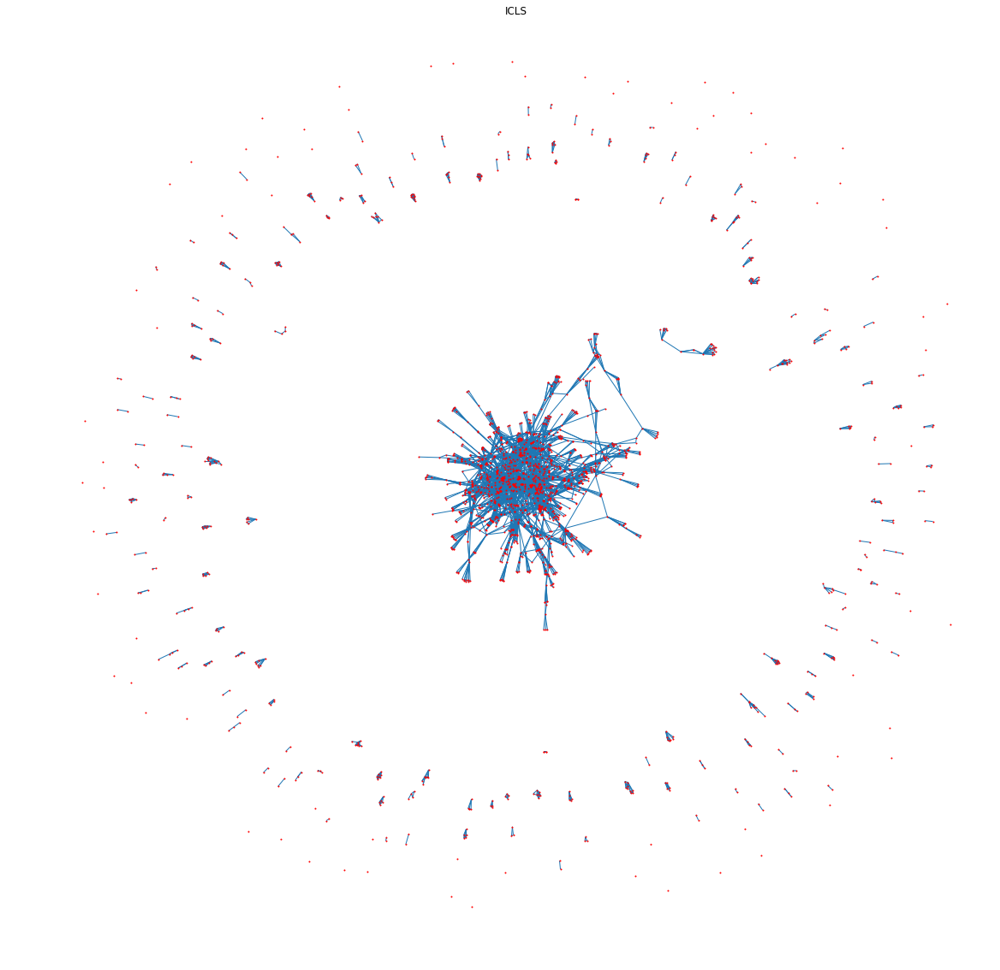

Density of the graph :  0.0035498690638767587
The largest component has  1319 nodes accounting for 66.55 % of the nodes
The diameter of the largest component is 17
The clustering coeff of is 0.7480136599430526


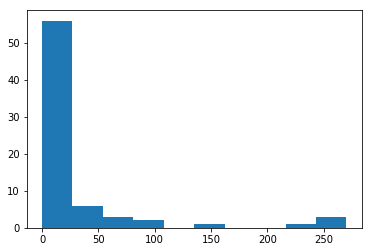

The average shortest path length in the main component is :  5.296950948032779
Attribute Assortativity coef: Country:  0.4080930661019727
Attribute Assortativity coef: Uni:  0.288156125828308
1       73
2       59
3       32
4       23
5       17
6        6
7        8
8        1
9        5
10       1
11       2
22       1
1319     1
dtype: int64


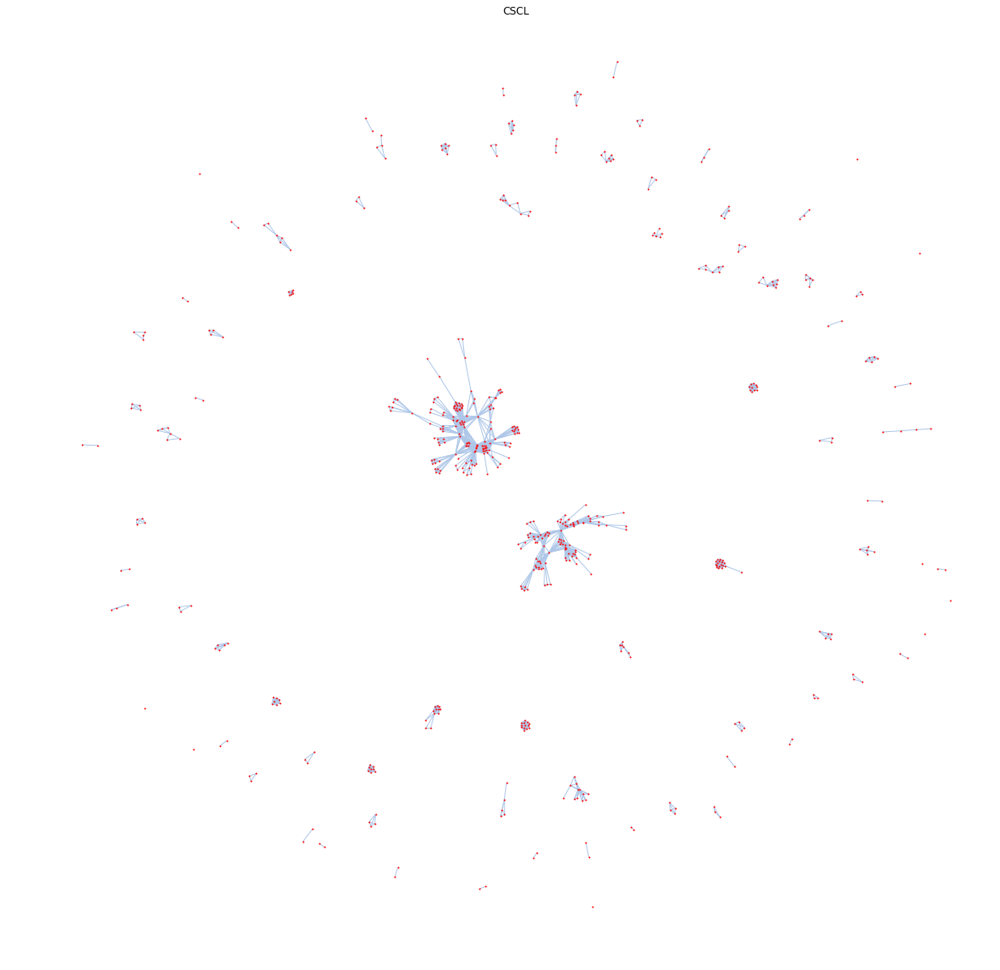

Density of the graph :  0.01197737090894291
The largest component has  154 nodes accounting for 26.24 % of the nodes
The diameter of the largest component is 8
The clustering coeff of is 0.8049079208806759


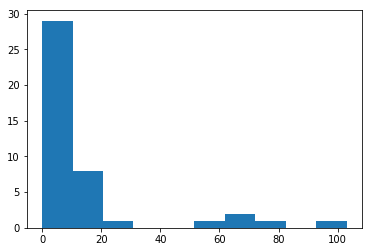

The average shortest path length in the main component is :  2.9921908157202273
Attribute Assortativity coef: Country:  0.4250347573661983
Attribute Assortativity coef: Uni:  0.3045497806216817
1      10
2      23
3      18
4      10
5       7
6       5
7       4
8       2
9       1
10      1
12      2
13      1
18      1
100     1
154     1
dtype: int64


In [126]:
for i, title in enumerate(['ICLS', 'CSCL']):
    year_assoc = associations[(associations.issued % 2 == i)]

    self_merge = pd.merge(year_assoc, year_assoc, on='file')
    self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

    #edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

    nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
    name_index = nodes.long_name.to_dict()
    name_index = {v: k for k, v in name_index.items()}

    self_merge['source'] = self_merge.long_name_x.map(name_index)
    self_merge['target'] = self_merge.long_name_y.map(name_index)

    adjacency = get_adjacency(nodes, self_merge)
    graph = nx.from_numpy_array(adjacency)
    
    plt.figure(figsize=(20, 20))
    plt.title(title)
    data = nodes.copy()
    #draw_map_plot(data, palette.as_hex()[i])


    embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)
    nx.draw(graph,  #pos = embedding, 
                           edge_color=palette.as_hex()[i], node_size = 1)
    plt.show()   

    nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
    nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
    nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')


    print('Density of the graph : ' , nx.density(graph))
    
    comp = list(nx.connected_components(graph))
    largest_comp = max(comp, key=len)
    percentage_lcc = len(largest_comp)/ graph.number_of_nodes() * 100
    print('The largest component has ',
          len(largest_comp), 'nodes',
          'accounting for %.2f'% percentage_lcc, 
          '% of the nodes')
    lcc = graph.subgraph(largest_comp)
    diameter = nx.diameter(lcc)
    print("The diameter of the largest component is", diameter)
    print("The clustering coeff of is",nx.average_clustering(graph))
    plt.hist(nx.degree_histogram(graph))
    plt.show()
    print("The average shortest path length in the main component is : " ,nx.average_shortest_path_length(lcc) )
    print('Attribute Assortativity coef: Country: ', nx.attribute_assortativity_coefficient(graph, 'country'))
    print('Attribute Assortativity coef: Uni: ', nx.attribute_assortativity_coefficient(graph, 'uni'))
    print(pd.Series([len(i) for i in comp]).value_counts().sort_index())

From the path length in the largest component we see that the core-cummunity (as given by collaboration) of CSCL seems to be much more close knit than the icls community. Looking at the previous graphs with separation by years this may partially be due to the many new participants in 2018's icls, but as 2016's icls also has a larger diameter, this might be an underlying pattern that could be confirmed with more data.

In [127]:
year_assoc = associations[(associations.issued % 2 == 1)]

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)


nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

graph=nx.relabel_nodes(graph, nodes.long_name.to_dict())
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
component = list(nx.connected_components(graph))


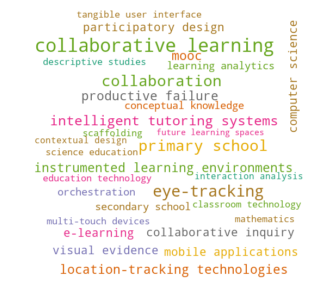

                             centrality
0                                      
Rummel, Nikol                  0.609668
Martinez-Maldonado, Roberto    0.174232
Prieto, Luis P.                0.135333
Sharma, Kshitij                0.107538
Thompson, Kate                 0.102700
Hecking, Tobias                0.088899
Hoppe, H. Ulrich               0.088899
Schneider, Bertrand            0.076376
Slotta, James D.               0.063183
Moher, Tom                     0.063183
Wen, Yun                       0.059369
Cober, Rebecca                 0.053185
Dillenbourg, Pierre            0.048169
Rau, Martina A.                0.040198
Mercier, Emma                  0.039992
Chounta, Irene-Angelica        0.039992
Fong, Cresencia                0.034632
Peppler, Kylie A               0.020202
Bodemer, Daniel                0.020202
Olsen, Jennifer K.             0.020202


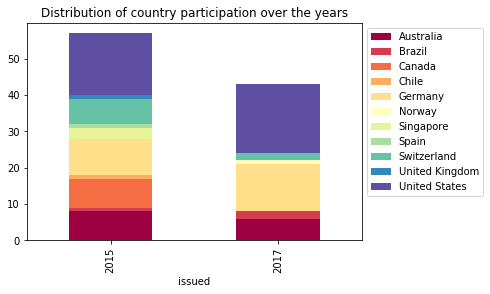

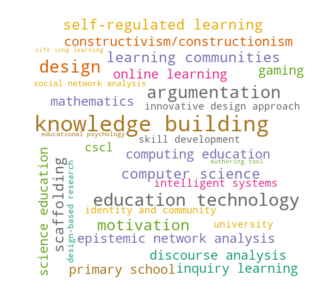

                         centrality
0                                  
Rosé, Carolyn Penstein    0.235889
Fischer, Frank             0.219271
Kirschner, Paul A.         0.218954
Wise, Alyssa Friend        0.172679
Hakkarainen, Kai           0.155133
Hmelo-Silver, Cindy E.     0.125129
Zhang, Jianwei             0.104817
Oshima, Jun                0.080264
Borge, Marcela             0.076625
Scardamalia, Marlene       0.076130
Chen, Mei-Hwa              0.053690
Järvelä, Sanna           0.047070
van Aalst, Jan             0.041994
Lund, Kristine             0.038700
Chen, Bodong               0.034464
Matsuzawa, Yoshiaki        0.034464
de Jong, Frank             0.028922
Wen, Miaomiao              0.025972
Quignard, Matthieu         0.025972
Hovey, Christopher M       0.025972


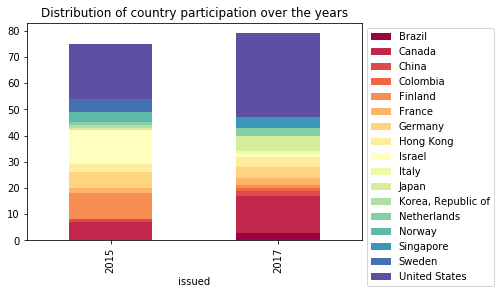

In [128]:
for cluster in [c for c in component if len(c) > 99]:
    comp = comp = graph.subgraph(cluster)
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(20)
    print(labels.set_index(0))
    
       
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show() 

In [129]:
colors = pd.Series({x: -1  for x in main_component.nodes})
colors = colors.reset_index()
colors[0] = colors['index'].map({ x: i+1 for i, c in enumerate(component)  for x in c if len(c) > 99})
colors = colors.fillna(2)

In [130]:
pos = nx.layout.spring_layout(main_component, seed=4)

In [131]:
node_size = np.array(list(nx.betweenness_centrality(main_component).values()))

In [132]:
colors[0].value_counts()

2.0    1337
8.0     154
7.0     100
Name: 0, dtype: int64

   1  ||  2  ||  3  ||  4


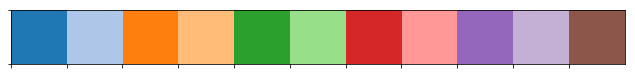

In [133]:
palette = sns.color_palette(palette='tab20', n_colors=11)#len(10)+1)

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 4+1))]))

In [134]:
p = palette.as_hex()

In [135]:
colors[0].value_counts()

2.0    1337
8.0     154
7.0     100
Name: 0, dtype: int64

In [136]:
col = colors[0].map({2:p[0], 7: p[6], 1:p[2]})

ValueError: 'c' argument must either be valid as mpl color(s) or as numbers to be mapped to colors. Here c = ['#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#d62728', '#d62728', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, '#1f77b4', '#1f77b4', nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#d62728', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', nan, '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#d62728', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4', '#1f77b4'].

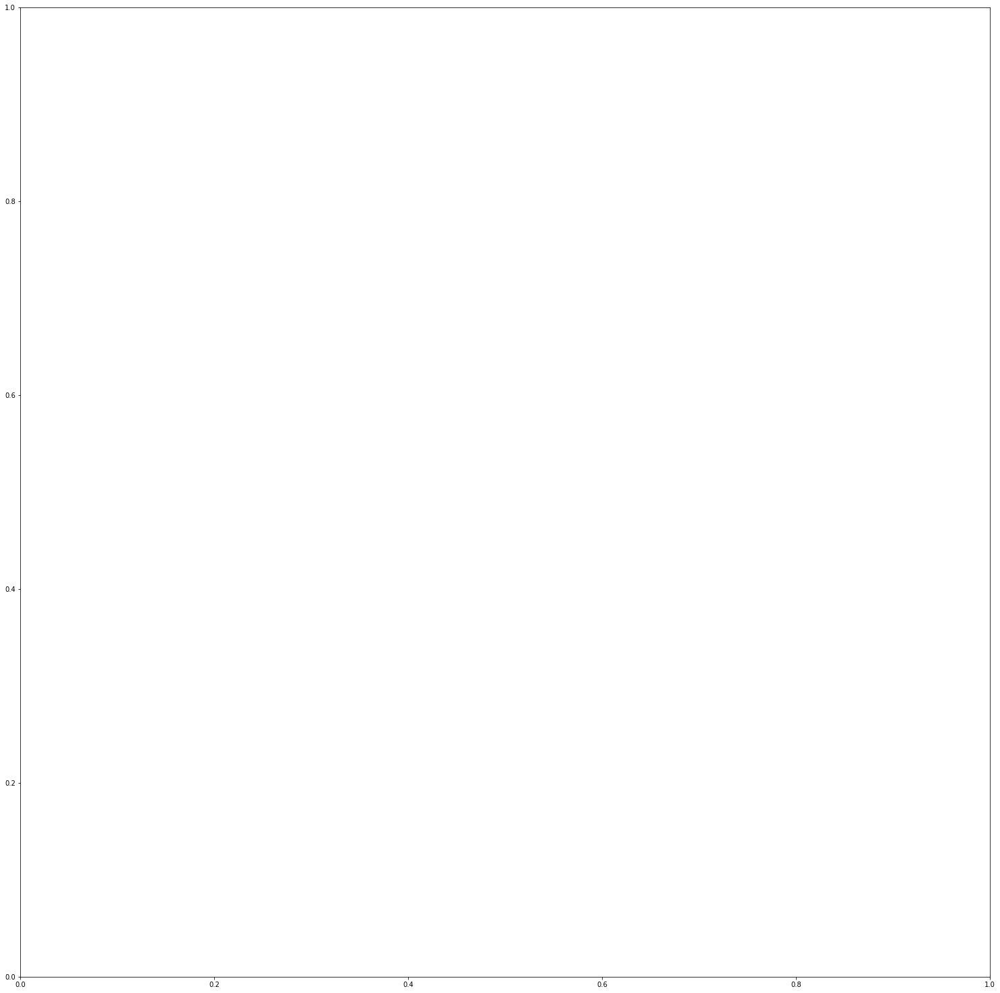

In [139]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, 
        node_color=col.tolist(),
#         cmap=ListedColormap(palette.as_hex()),
        node_size=(node_size+node_size.mean())*6000,
        #labels=labels,
        edge_color='grey')
plt.savefig('figures/CSCL_componets')

In [140]:
ICLS_only = set(associations[associations.issued % 2 == 0].long_name.unique()) - set(associations[associations.issued % 2 == 1].long_name.unique())

In [141]:
colors[0] = colors['index'].map({ x: i+1 for i, c in enumerate(component)  for x in c if len(c) > 99})
colors.loc[colors['index'].isin(ICLS_only), 0] = 3
colors = colors.fillna(2)

In [142]:
colors[0].value_counts()

3.0    1137
2.0     200
8.0     154
7.0     100
Name: 0, dtype: int64

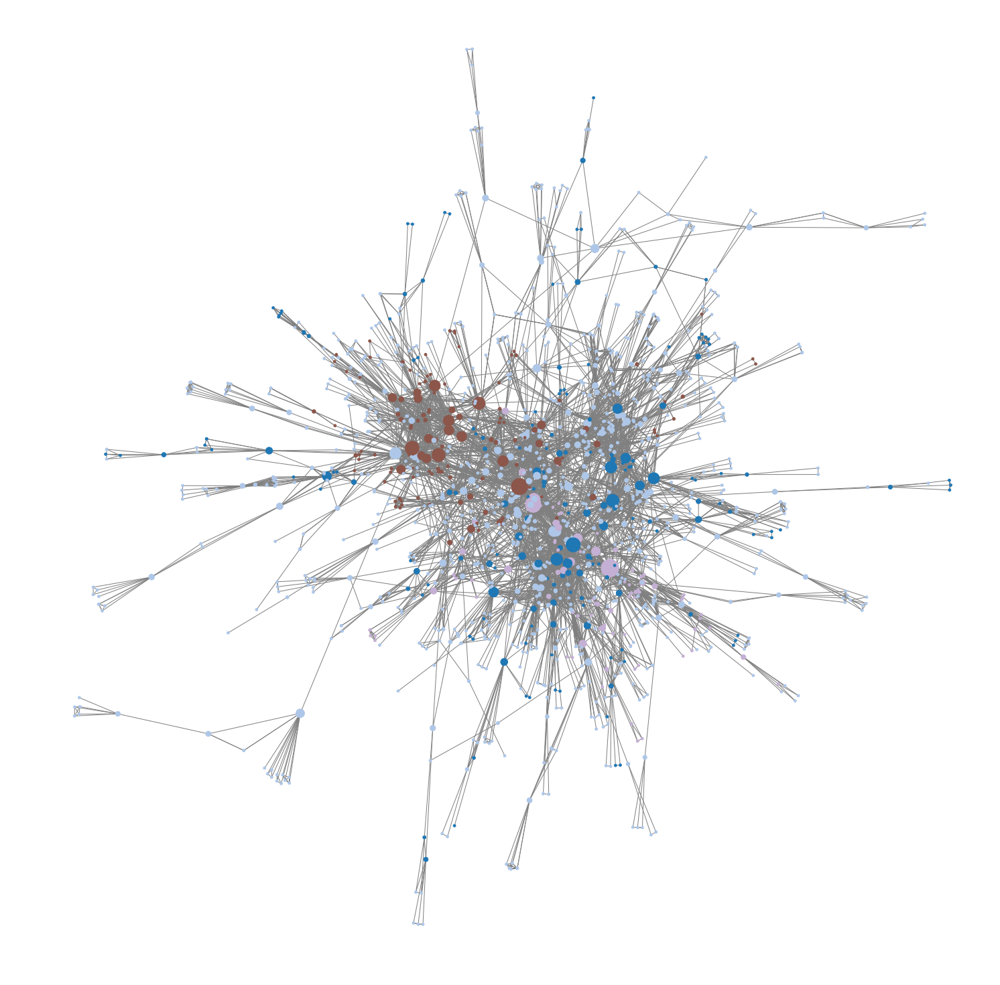

In [143]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, 
        node_color=colors[0].tolist(),
        cmap=ListedColormap(palette.as_hex()),
        node_size=(node_size+node_size.mean())*6000,
        #labels=labels,
        edge_color='grey')

In [144]:
year_assoc = associations[(associations.issued % 2 == 0)]

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)


nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

graph=nx.relabel_nodes(graph, nodes.long_name.to_dict())
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
component = list(nx.connected_components(graph))

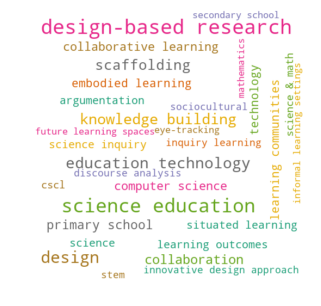

                         centrality
0                                  
Enyedy, Noel               0.109523
Rummel, Nikol              0.101970
Bang, Megan                0.075775
Sandoval, William A.       0.074218
Fischer, Frank             0.066255
Rosé, Carolyn Penstein    0.064157
Slotta, James D.           0.063038
Quintana, Chris            0.060763
Shapiro, R. Benjamin       0.055564
Polman, Joseph L.          0.055160
Rosé, Carolyn              0.053829
Clarke, Sherice            0.052422
Arastoopour, Golnaz        0.052156
van Leeuwen, Anouschka     0.050181
Popov, Vitaliy             0.048092
Kafai, Yasmin B.           0.047804
Horn, Mike                 0.046854
Bell, Philip               0.045319
Lindgren, Robb             0.045274
Puntambekar, Sadhana       0.044843


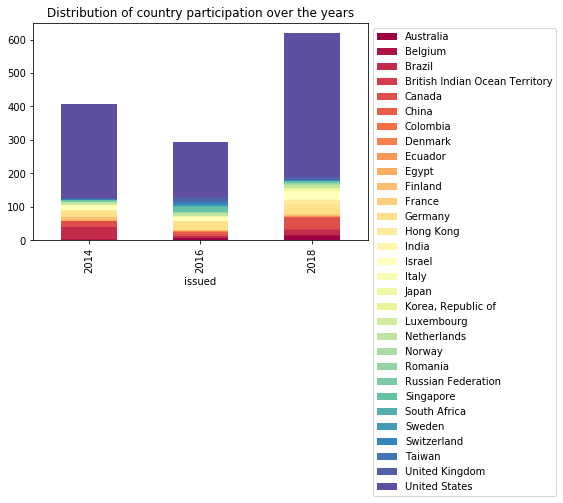

spectral clustering
7    912
8    128
2     67
0     59
4     37
1     34
6     25
3     23
5     20
9     14
dtype: int64


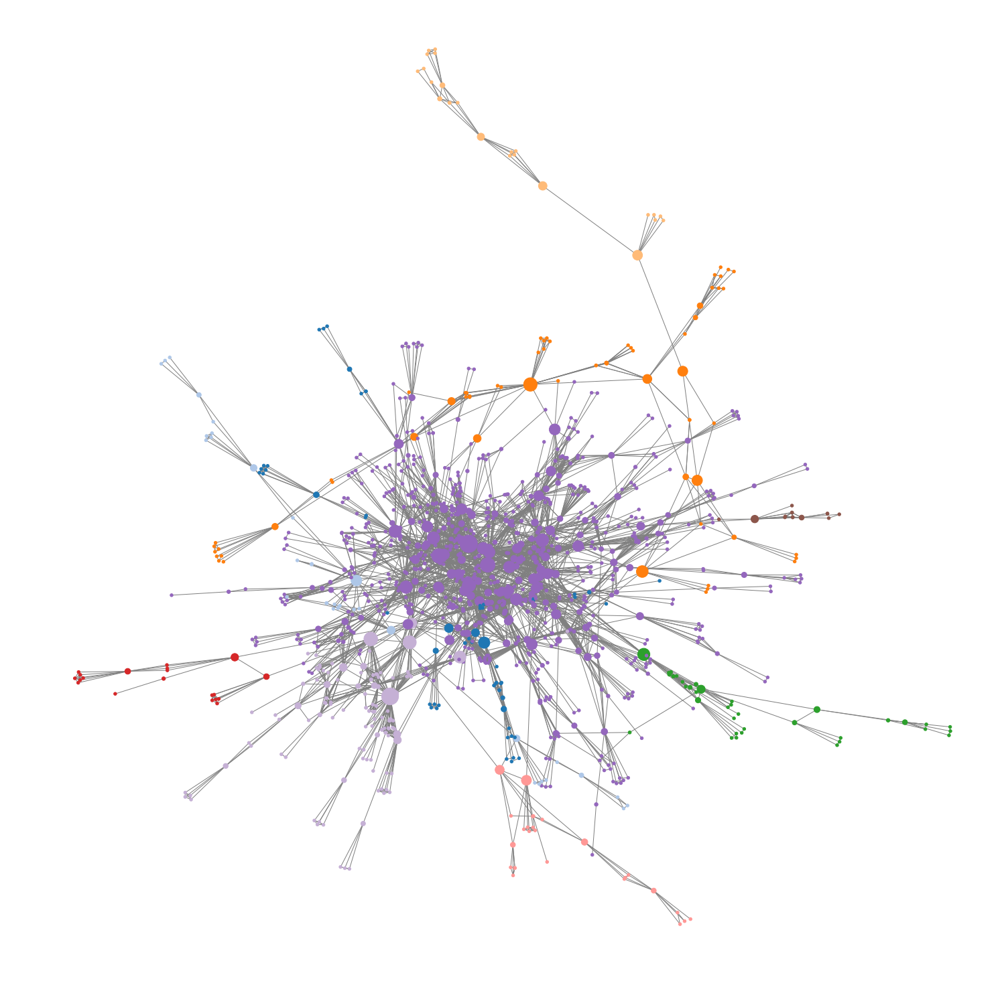

In [145]:
for cluster in [c for c in component if len(c) > 99]:
    comp = graph.subgraph(cluster)
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(20)
    print(labels.set_index(0))
    
       
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show() 
    from sklearn.cluster import SpectralClustering

    # Cluster
    sc = SpectralClustering(n_cluster, affinity='precomputed', n_init=100)
    sc.fit(nx.adj_matrix(comp))

    # Compare ground-truth and clustering-results
    print('spectral clustering')
    print(pd.Series(sc.labels_).value_counts())
    
    plt.figure(figsize=(20, 20))

    nx.draw(comp, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )
    plt.show()

## Re-examining 2018: how do nodes join?

In [146]:
previous_participation = set(associations[~associations.issued.isin([2018])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2018)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]


nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
nodes = nodes[nodes.Lon.notna()]

name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}



self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)


adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)

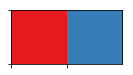

In [147]:
palette = sns.color_palette(palette='Set1', n_colors=2)

sns.palplot(palette)

We see that some of the new nodes joining in 2018 partly attach to people who already have participated in the conference in pervious years, while others join independently.

In red we have ned nodes, blue for old nodes.

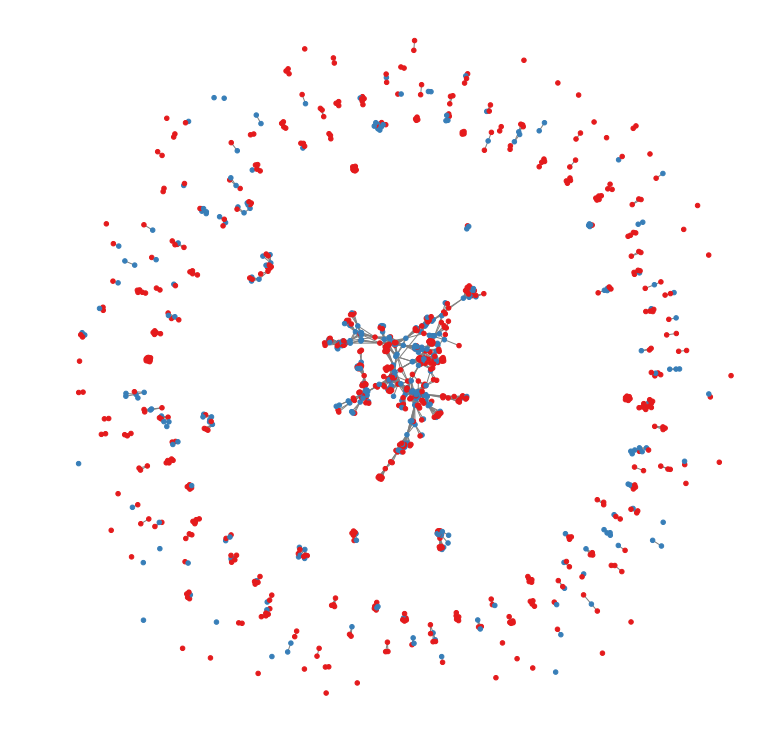

In [148]:
plt.figure(figsize=(10, 10))
nx.draw_spring(graph, cmap=ListedColormap(palette.as_hex()), 
               node_color=nodes.prev.tolist(), width = 1,  edge_color='grey', node_size=[20, 20])

We now analyze these mentors and mentees:

In [149]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [150]:
mentees.long_name_y.drop_duplicates().shape

(306,)

And the institutions they are affiliated with:

In [151]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

Stanford University                  16
University of Colorado at Boulder    15
University of Wisconsin - Madison    13
Indiana University at Bloomington    13
University of Hong Kong              13
Northwestern University              13
New York University                  12
Carnegie Mellon University            9
Rutgers University, Newark            9
University of Haifa                   8
Name: name_y, dtype: int64

In [152]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

United States     172
Israel             15
Hong Kong          13
Germany            12
Canada              9
Finland             6
United Kingdom      6
Australia           5
Netherlands         5
Japan               5
Name: country_y, dtype: int64

The corresponding mentors:

In [153]:
mentees[~mentees[['long_name_x', 'file']].duplicated()].long_name_x.value_counts().head(10)

Silver, Cindy Hmelo      4
Horn, Mike               4
Zohar, Asnat R.          3
Shaw, Mia                3
Fitzgerald, Miranda S    3
Betser, Sagit            3
Moczek, Armin            3
Tu, Xintian              3
Davis, Bria              3
Penuel, Bill             3
Name: long_name_x, dtype: int64

Looking at lone wolf participants:

In [154]:
def get_loners(mentoring_connections):
    loner_mask = (mentoring_connections.groupby('file').prev_x.sum() + mentoring_connections.groupby('file').prev_y.sum())
    loner_mask = loner_mask[loner_mask == 0].index.tolist()
    return mentoring_connections[mentoring_connections.file.isin(loner_mask)]

In [155]:
lone_wolfs = get_loners(mentoring_connections)

In [156]:
lone_wolfs.long_name_y.drop_duplicates().shape

(239,)

In [157]:
lone_wolfs[~lone_wolfs[['long_name_x', 'file']].duplicated()].long_name_x.value_counts().head()

Brooks, Christopher    3
DeVane, Benjamin       2
Missall, Kristen       2
Nanda, Salloni         2
Iyer, Sridhar          2
Name: long_name_x, dtype: int64

Here comes in the increase of americans in 2018!

In [158]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

Pennsylvania State University         3
University of Iowa                    3
University of Michigan - Ann Arbor    3
University of Delaware                3
University of Illinois at Chicago     3
Name: name_x, dtype: int64

In [159]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

United States         53
United Kingdom         4
Germany                3
Korea, Republic of     3
India                  2
China                  2
Cyprus                 2
Norway                 2
Australia              2
Japan                  1
Name: country_x, dtype: int64

We should also consider the number of papers, not only the number of participants:

In [160]:
mentees.file.unique().shape

(232,)

In [161]:
lone_wolfs.file.unique().shape

(79,)

In [162]:
mentoring_connections.file.unique().shape

(363,)

The number of papers written uniquely by veterans is then:

In [163]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

52

**We take this idea and apply it to the previous years to get a point of comparisoon:**

#### For 2017

In [164]:
previous_participation = set(associations[~associations.issued.isin([2018, 2017])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2017)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]

In [165]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [166]:
mentees.long_name_y.drop_duplicates().shape

(118,)

And the institutions they are affiliated with:

In [167]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

University of Wisconsin - Madison         7
Carnegie Mellon University                5
University of Pennsylvania                5
Pennsylvania State University             4
Vanderbilt University                     4
University of Washington                  4
University of Toronto                     4
Indiana University at Bloomington         4
State University of New York at Albany    4
Utah State University                     3
Name: name_y, dtype: int64

In [168]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

United States    45
Canada            5
Germany           5
Japan             4
Switzerland       3
Hong Kong         3
Sweden            2
Singapore         2
Romania           2
Taiwan            1
Name: country_y, dtype: int64

We see that in 2017, the number of new participants is much more consistend with numbers of incomming phd et. comming into the field.

Again, looking at lone wolf participants:

In [169]:
lone_wolfs = lone_wolfs = get_loners(mentoring_connections)
lone_wolfs.long_name_y.drop_duplicates().shape

(71,)

We also see much fewer lone wolf participants:

In [170]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

George Mason University              3
University of Florida                2
University of Southampton            1
University of Illinois at Chicago    1
University of Toronto                1
Name: name_x, dtype: int64

In [171]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

United States     18
Canada             2
Brazil             1
China              1
United Kingdom     1
Germany            1
Name: country_x, dtype: int64

We should also consider the number of papers, not only the number of participants:

In [172]:
mentees.file.unique().shape

(61,)

In [173]:
lone_wolfs.file.unique().shape

(20,)

In [174]:
mentoring_connections.file.unique().shape

(103,)

The number of papers written uniquely by veterans is then:

In [175]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

22

#### For 2016

In [176]:
previous_participation = set(associations[~associations.issued.isin([2018, 2017, 2016])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2016)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]

In [177]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [178]:
mentees.long_name_y.drop_duplicates().shape

(144,)

And the institutions they are affiliated with:

In [179]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

University of Colorado at Boulder         8
University of California, Berkeley        7
Indiana University at Bloomington         6
University of Wisconsin - Madison         6
University of Toronto                     5
Ludwig-Maximilians-Universität München    4
Hebrew University of Jerusalem            4
University of Washington                  4
University of Pennsylvania                3
Northwestern University                   3
Name: name_y, dtype: int64

In [180]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

United States    65
Germany           8
Israel            6
Canada            6
Australia         4
Switzerland       3
Hong Kong         2
Italy             2
Netherlands       2
Finland           2
Name: country_y, dtype: int64

We see that in 2017, the number of new participants is much more consistend with numbers of incomming phd et. comming into the field.

Again, looking at lone wolf participants:

In [181]:
lone_wolfs = get_loners(mentoring_connections)
lone_wolfs.long_name_y.drop_duplicates().shape

(61,)

We also see much fewer lone wolf participants:

In [182]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

Columbia University                 4
Universität Duisburg-Essen          3
Ministry of Education, Singapore    2
Rutgers University, Newark          2
Nanyang Technological University    2
Name: name_x, dtype: int64

In [183]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

United States     9
United Kingdom    4
Germany           4
Singapore         3
Netherlands       2
Israel            2
India             1
Finland           1
China             1
Name: country_x, dtype: int64

We should also consider the number of papers, not only the number of participants:

In [184]:
mentees.file.unique().shape

(85,)

In [185]:
lone_wolfs.file.unique().shape

(23,)

In [186]:
mentoring_connections.file.unique().shape

(132,)

The number of papers written uniquely by veterans is then:

In [187]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

24